TODO:
- for each Assembly (central, elite, local):
  - Map
  - What other mechanisms, etc. are associated? 
- Timeline (all)

### Imports

In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.patches as mpatches

%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [3]:
from sklearn.preprocessing import Normalizer

In [4]:
from chart_studio import plotly
import plotly.figure_factory as ff

In [5]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

In [6]:
fig_dir = '../v2-fig/fig-assemblies/'

In [7]:
gov_arch_csv = '../data/v2/communities_data_prepped.csv'

In [8]:
gov_df = pd.read_csv(gov_arch_csv)

In [9]:
gov_df.head()

,Name,Institutions,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Metanotes,Heterogeneity,FC comments,expert check,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mecha

# Assemblies Analysis

#### Create categories for elite/no elite for central and local 

In [10]:
assemblies = [
 'decision_making_mechanisms_include_assembly_central',
 'decision_making_mechanisms_include_assembly_central_elite',
 'decision_making_mechanisms_include_assembly_central_no_elite',
 'decision_making_mechanisms_include_assembly_local',
 'decision_making_mechanisms_include_assembly_local_elite',
 'decision_making_mechanisms_include_assembly_local_no_elite',
 'decision_making_mechanisms_include_assembly_elite',
]

In [11]:
central_assemblies = [
 'decision_making_mechanisms_include_assembly_central',
 'decision_making_mechanisms_include_assembly_central_elite',
 'decision_making_mechanisms_include_assembly_central_no_elite',
]

In [12]:
local_assemblies = [
 'decision_making_mechanisms_include_assembly_local',
 'decision_making_mechanisms_include_assembly_local_elite',
 'decision_making_mechanisms_include_assembly_local_no_elite',
]

In [13]:
gov_df['decision_making_mechanisms_include_assembly_central_elite'] = np.where(((gov_df['decision_making_mechanisms_include_assembly_central'] == 1) & (gov_df['decision_making_mechanisms_include_assembly_elite'] == 1)), 1, 0)

In [14]:
gov_df['decision_making_mechanisms_include_assembly_central_no_elite'] = np.where(((gov_df['decision_making_mechanisms_include_assembly_central'] == 1) & (gov_df['decision_making_mechanisms_include_assembly_elite'] == 0)), 1, 0)

In [15]:
gov_df['decision_making_mechanisms_include_assembly_local_elite'] = np.where(((gov_df['decision_making_mechanisms_include_assembly_local'] == 1) & (gov_df['decision_making_mechanisms_include_assembly_elite'] == 1)), 1, 0)

In [16]:
gov_df['decision_making_mechanisms_include_assembly_local_no_elite'] = np.where(((gov_df['decision_making_mechanisms_include_assembly_local'] == 1) & (gov_df['decision_making_mechanisms_include_assembly_elite'] == 0)), 1, 0)

In [17]:
gov_df[assemblies].head()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,0,0,0,0,0,0,0
1,1,0,1,0,0,0,0
2,0,0,0,0,0,0,0
3,1,0,1,0,0,0,0
4,0,0,0,0,0,0,0


In [18]:
gov_df[assemblies].sum()

decision_making_mechanisms_include_assembly_central             27
decision_making_mechanisms_include_assembly_central_elite        9
decision_making_mechanisms_include_assembly_central_no_elite    18
decision_making_mechanisms_include_assembly_local               11
decision_making_mechanisms_include_assembly_local_elite          4
decision_making_mechanisms_include_assembly_local_no_elite       7
decision_making_mechanisms_include_assembly_elite               10
dtype: int64

## Correlations

In [19]:
data_plot = gov_df.select_dtypes(include=[np.number]).dropna()

In [20]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [21]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [22]:
assemblies_corr = norm_corr[assemblies]

In [23]:
assemblies_corr

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
Time span: Start,-0.525026,-0.170904,-0.465054,-0.006269,-0.076244,0.082497,-0.152996
Time span: End,-0.391089,-0.153971,-0.334392,-0.017346,-0.036980,0.018443,-0.140952
enforcement_mechanisms_include_seizing_of_property,0.218763,0.652080,-0.068176,-0.060614,-0.034854,-0.049361,0.643993
decision_making_mechanisms_include_public_meetings,0.303989,0.514295,0.081963,0.203046,0.246553,0.008816,0.502971
decision_making_mechanisms_include_power_fluidity,-0.071823,-0.041587,-0.055409,-0.049262,-0.028327,-0.040117,-0.043857
decision_making_mechanisms_include_petition,-0.071823,-0.041587,-0.055409,-0.049262,-0.028327,-0.040117,-0.043857
decision_making_mechanisms_include_veto,0.305374,0.467873,0.104327,-0.079241,-0.045565,-0.064530,0.460195
decision_making_mechanisms_include_representation,-0.103763,0.067844,-0.137738,0.112793,0.191367,-0.060716,0.098526
decision_making_mechanisms_include_rule_of_law,0.250249,0.619977,-0.021186,-0.064650,-0.037175,-0.052648,0.611919
enforcement_mechanisms_include_appeal,0.018586,-0.069775,0.050657,0.233324,-0.047527,0.409128,-0.073584


In [28]:
plt.figure(figsize=(30,30))
sns.heatmap(
    assemblies_corr, 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'all_assemblies_unsorted_corr.png', bbox_inches='tight')
plt.show()

In [29]:
plt.figure(figsize=(30,30))
sns.heatmap(
    assemblies_corr.sort_values(by='decision_making_mechanisms_include_assembly_central', ascending=False), 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'all_assemblies_corr.png')
plt.show()

In [30]:
plt.figure(figsize=(30,30))
sns.heatmap(
    assemblies_corr[central_assemblies].sort_values(by='decision_making_mechanisms_include_assembly_central', ascending=False), 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'central_assemblies_corr.png')
plt.show()

In [31]:
plt.figure(figsize=(30,30))
sns.heatmap(
    assemblies_corr[local_assemblies].sort_values(by='decision_making_mechanisms_include_assembly_local', ascending=False), 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'local_assemblies_corr.png')
plt.show()

### Filter by mechanism type: Access, Enforcement, Decision Making

In [33]:
col_list = list(gov_df.columns.values)
col_list

['Name',
 'Institutions',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Metanotes',
 'Heterogeneity ',
 'FC comments',
 'expert check',
 'enforcement_mechanisms_include_seizing_of_property',
 'decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'enforcement_mechanisms_include_destruction_of_property',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'enforcement_mechanisms_include_mediation',
 'access_mechanisms_include_matrilineality',

#### Access mechanisms

In [34]:
access_cols = [col for col in col_list if col.startswith('access_')]
access_cols

['access_mechanisms_include_matrilineality',
 'access_mechanisms_include_patronage_for_office',
 'access_mechanisms_include_age_boundaries',
 'access_mechanisms_include_blood_relations',
 'access_mechanisms_include_life_appointment',
 'access_mechanisms_include_heredity',
 'access_mechanisms_include_popularity_',
 'access_mechanisms_include_divine_right',
 'access_mechanisms_include_co-optation',
 'access_mechanisms_include_female_participation',
 'access_mechanisms_include_election',
 'access_mechanisms_include_screening_process',
 'access_mechanisms_include_gerontocracy',
 'access_mechanisms_include_payment_for_occupying_office',
 'access_mechanisms_include_property_requirement',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_open_political_unit',
 'access_mechanisms_include_dreaming',
 'access_mechanisms_include_matriarchy',
 'access_mechanisms_include_meritocracy',
 'access_mechanisms_include_lottery_random_selection',
 'access_mechanisms_include_inductio

In [35]:
access_corr = assemblies_corr.loc[access_cols]
access_corr.head()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
access_mechanisms_include_matrilineality,-0.180967,-0.104782,-0.139609,-0.029896,-0.071373,0.040997,-0.110503
access_mechanisms_include_patronage_for_office,-0.124844,-0.072286,-0.096312,-0.085629,-0.049238,-0.069732,-0.076233
access_mechanisms_include_age_boundaries,0.298798,0.464343,0.099129,-0.084027,-0.048317,-0.068427,0.456441
access_mechanisms_include_blood_relations,0.283632,0.049100,0.270728,0.096221,0.221249,-0.121740,0.040891
access_mechanisms_include_life_appointment,0.020322,0.086390,-0.017975,0.323465,0.214876,0.228588,0.082059


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_56373/3067452565.py:10: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


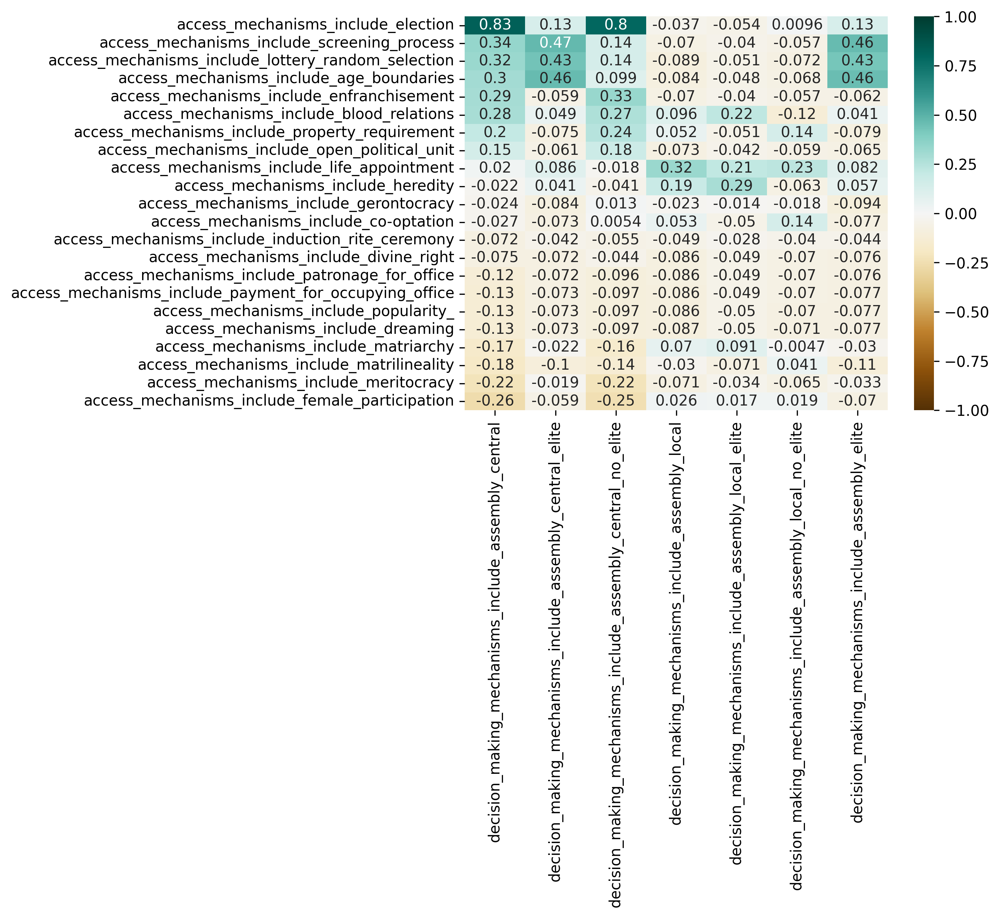

In [36]:
# plt.figure(figsize=(40,40))
sns.heatmap(
    access_corr.sort_values(by='decision_making_mechanisms_include_assembly_central', ascending=False), 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_corr_access.png', bbox_inches='tight')
plt.show()

#### Enforcement mechanisms

In [37]:
enforcement_cols = [col for col in col_list if col.startswith('enforcement_')]
enforcement_cols

['enforcement_mechanisms_include_seizing_of_property',
 'enforcement_mechanisms_include_appeal',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_destruction_of_property',
 'enforcement_mechanisms_include_mediation',
 'enforcement_mechanisms_include_judicial_review',
 'enforcement_mechanisms_include_monitoring',
 'enforcement_mechanisms_include_graduated_sanctions',
 'enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription',
 'enforcement_mechanisms_include_capital_punishment',
 'enforcement_mechanisms_include_jury_judge',
 'enforcement_mechanisms_include_self-help',
 'enforcement_mechanisms_include_police',
 'enforcement_mechanisms_include_reputational_risk',
 'enforcement_mechanisms_include_paying_damages_compensation',
 'enforcement_mechanisms_include_negotiation',
 'enforcement_mechanisms_include_criticism_mocking_joking',
 'enforcement_mechanisms_include_civil_disobedience',
 'enforcement_mechanisms_include_corporal_punishment_

In [38]:
enforcement_corr = assemblies_corr.loc[enforcement_cols]
enforcement_corr.head()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
enforcement_mechanisms_include_seizing_of_property,0.218763,0.652080,-0.068176,-0.060614,-0.034854,-0.049361,0.643993
enforcement_mechanisms_include_appeal,0.018586,-0.069775,0.050657,0.233324,-0.047527,0.409128,-0.073584
enforcement_mechanisms_include_tribunal_court_,0.437185,0.405014,0.268778,0.029290,0.018084,0.022355,0.392878
enforcement_mechanisms_include_destruction_of_property,-0.102262,-0.059211,-0.078890,-0.070140,-0.040332,-0.057118,-0.062443
enforcement_mechanisms_include_mediation,-0.016576,-0.069912,0.014411,0.019849,-0.047621,0.087358,-0.073729


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_56373/3729512812.py:10: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


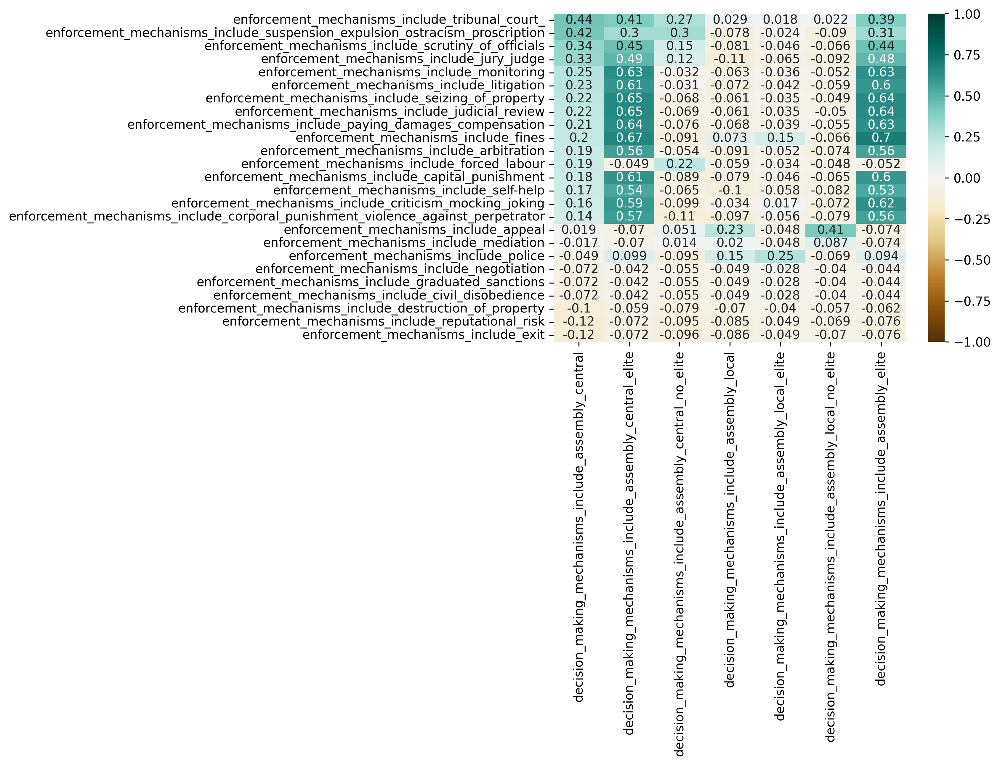

In [39]:
# plt.figure(figsize=(40,40))
sns.heatmap(
    enforcement_corr.sort_values(by='decision_making_mechanisms_include_assembly_central', ascending=False), 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_corr_enforcement.png', bbox_inches='tight')
plt.show()

#### Decision making mechanisms

In [40]:
decision_making_cols = [col for col in col_list if col.startswith('decision_making_')]
decision_making_cols

['decision_making_mechanisms_include_public_meetings',
 'decision_making_mechanisms_include_power_fluidity',
 'decision_making_mechanisms_include_petition',
 'decision_making_mechanisms_include_veto',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_rule_of_law',
 'decision_making_mechanisms_include_kingchief-as-figurehead',
 'decision_making_mechanisms_include_remunerated_position',
 'decision_making_mechanisms_include_voting',
 'decision_making_mechanisms_include_ratification_acclamation_only',
 'decision_making_mechanisms_include_checks_and_balances',
 'decision_making_mechanisms_include_plurality_voting',
 'decision_making_mechanisms_include_dual-sex_political_system',
 'decision_making_mechanisms_include_word_of_mouth',
 'decision_making_mechanisms_include_assembly_central',
 'decision_making_mechanisms_include_agenda_setting',
 'decision_making_mechanisms_include_group_voting',
 'decision_making_mechanisms_include_consent',
 'decision_mak

In [41]:
decision_making_corr = assemblies_corr.loc[decision_making_cols]
decision_making_corr.head()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
decision_making_mechanisms_include_public_meetings,0.303989,0.514295,0.081963,0.203046,0.246553,0.008816,0.502971
decision_making_mechanisms_include_power_fluidity,-0.071823,-0.041587,-0.055409,-0.049262,-0.028327,-0.040117,-0.043857
decision_making_mechanisms_include_petition,-0.071823,-0.041587,-0.055409,-0.049262,-0.028327,-0.040117,-0.043857
decision_making_mechanisms_include_veto,0.305374,0.467873,0.104327,-0.079241,-0.045565,-0.064530,0.460195
decision_making_mechanisms_include_representation,-0.103763,0.067844,-0.137738,0.112793,0.191367,-0.060716,0.098526


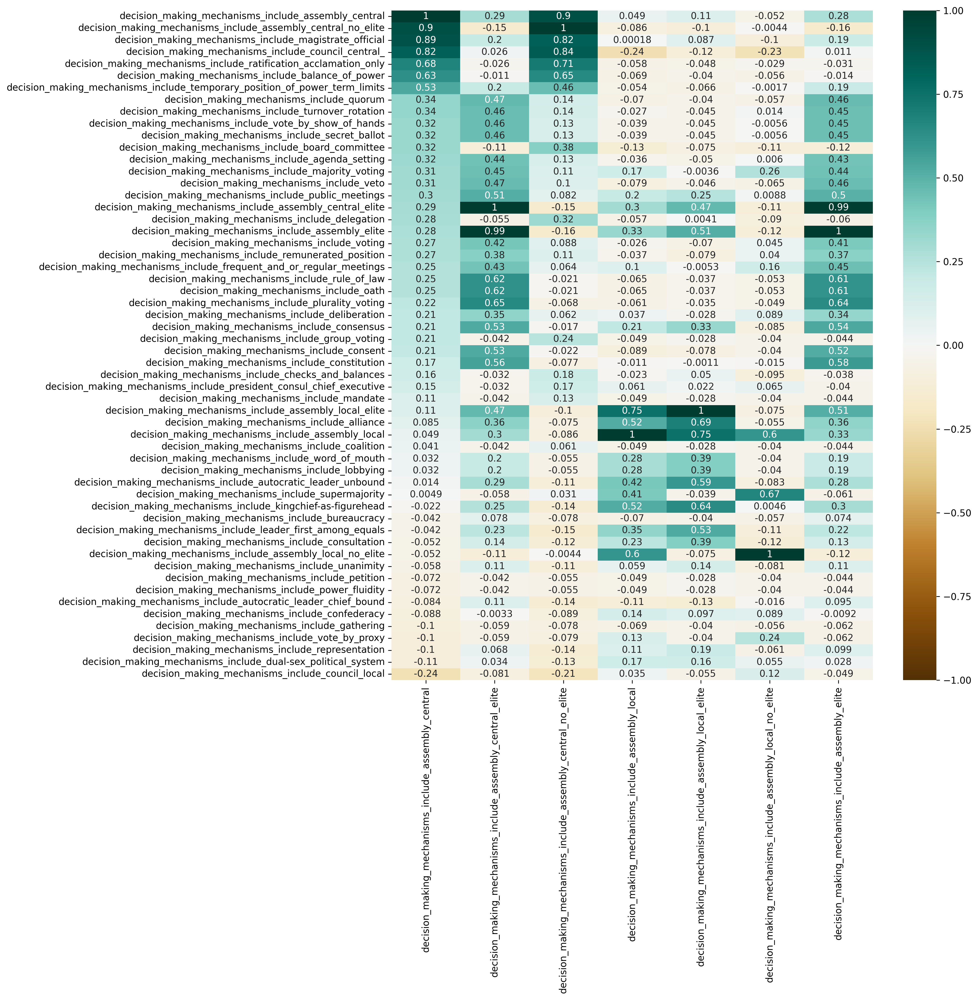

In [42]:
plt.figure(figsize=(15,15))
sns.heatmap(
    decision_making_corr.sort_values(by='decision_making_mechanisms_include_assembly_central', ascending=False), 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_corr_decision_making.png', bbox_inches='tight')
plt.show()

### Size correlations

In [43]:
size_cols = [col for col in col_list if col.startswith('Size:')]
size_cols

['Size: 100 - 1,000',
 'Size: 1,001 - 10,000',
 'Size: 10,001 - 100,000',
 'Size: 100,001 - 1,000,000',
 'Size: 1,000,001 - 10,000,000',
 'Size: 10,000,000+',
 'Size: Unknown']

In [44]:
size_corr = assemblies_corr.loc[size_cols]
size_corr.head()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
"Size: 100 - 1,000",-0.071823,-0.041587,-0.055409,-0.049262,-0.028327,-0.040117,-0.043857
"Size: 1,001 - 10,000",0.032761,-0.037830,0.050888,-0.078607,0.002757,-0.121851,-0.045392
"Size: 10,001 - 100,000",0.184004,-0.181966,0.272057,-0.103700,-0.159813,0.036372,-0.195172
"Size: 100,001 - 1,000,000",0.707960,0.174119,0.652497,-0.087872,-0.061622,-0.058180,0.167188
"Size: 1,000,001 - 10,000,000",0.168269,0.121679,0.118877,0.054167,0.063317,0.005314,0.115209


/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_56373/401215558.py:10: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


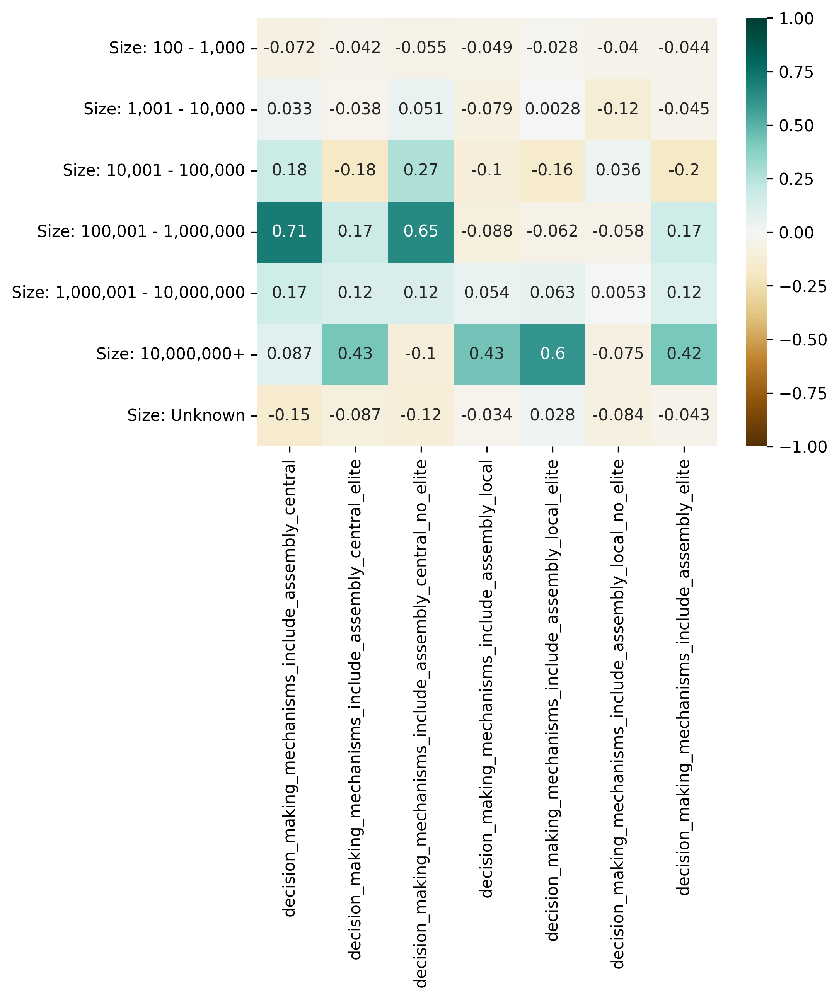

In [47]:
# plt.figure(figsize=(40,40))
sns.heatmap(
    size_corr, 
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'mechanisms_corr_size.png', bbox_inches='tight')
plt.show()

### Get correlations for each assembly type

#### Central assemblies

In [56]:
central_corr = assemblies_corr['decision_making_mechanisms_include_assembly_central']

In [57]:
central_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_central_corr.csv')

In [58]:
central_corr.sort_values(ascending=False)

decision_making_mechanisms_include_assembly_central                                1.000000
decision_making_mechanisms_include_assembly_central_no_elite                       0.902038
decision_making_mechanisms_include_magistrate_official                             0.886779
access_mechanisms_include_election                                                 0.826599
decision_making_mechanisms_include_council_central_                                0.822871
Region: Europe                                                                     0.813048
Size: 100,001 - 1,000,000                                                          0.707960
decision_making_mechanisms_include_ratification_acclamation_only                   0.677918
Geography: Europe North                                                            0.633484
decision_making_mechanisms_include_balance_of_power                                0.625749
Time span: Duration                                                             

In [59]:
central_corr.sort_values(ascending=True)

Time span: Start                                                                  -0.525026
Time span: End                                                                    -0.391089
access_mechanisms_include_female_participation                                    -0.263478
decision_making_mechanisms_include_council_local                                  -0.240691
access_mechanisms_include_meritocracy                                             -0.221857
Region: North America                                                             -0.214377
Geography: North America                                                          -0.182498
access_mechanisms_include_matrilineality                                          -0.180967
access_mechanisms_include_matriarchy                                              -0.166337
Size: Unknown                                                                     -0.150096
Region: Central America                                                         

In [60]:
central_corr.sort_values(ascending=False).to_frame()

,decision_making_mechanisms_include_assembly_central
decision_making_mechanisms_include_assembly_central,1.000000
decision_making_mechanisms_include_assembly_central_no_elite,0.902038
decision_making_mechanisms_include_magistrate_official,0.886779
access_mechanisms_include_election,0.826599
decision_making_mechanisms_include_council_central_,0.822871
Region: Europe,0.813048
"Size: 100,001 - 1,000,000",0.707960
decision_making_mechanisms_include_ratification_acclamation_only,0.677918
Geography: Europe North,0.633484
decision_making_mechanisms_include_balance_of_power,0.625749


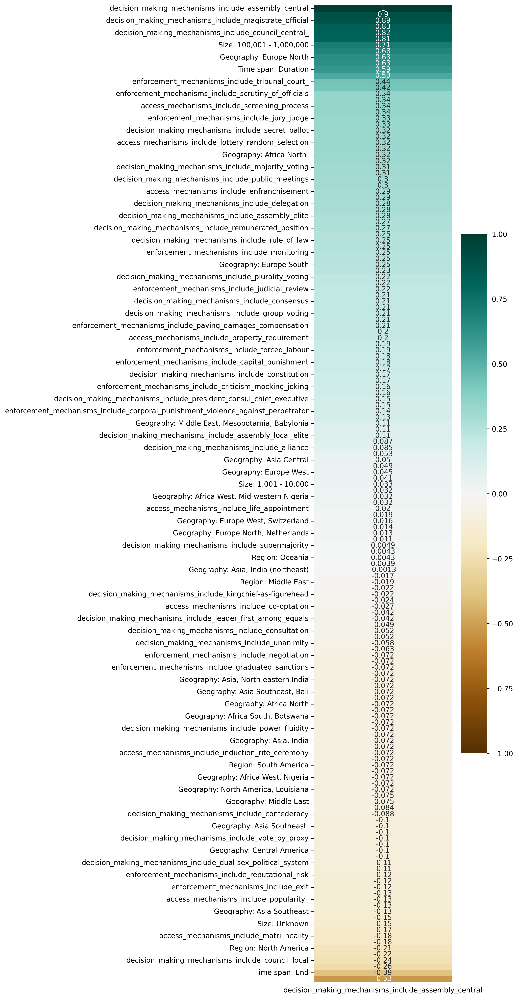

In [64]:
plt.figure(figsize=(10,20))
sns.heatmap(
    central_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'central_assemblies_corr.png')
plt.show()

In [65]:
central_elite_corr = assemblies_corr['decision_making_mechanisms_include_assembly_central_elite']

In [66]:
central_elite_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_central_elite_corr.csv')

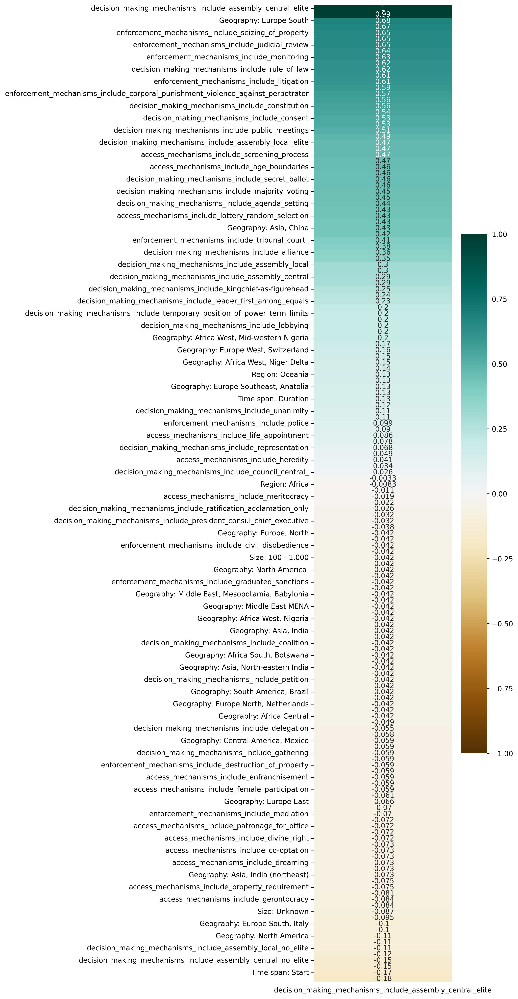

In [67]:
plt.figure(figsize=(10,20))
sns.heatmap(
    central_elite_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'central_elite_assemblies_corr.png')
plt.show()

In [68]:
central_elite_corr = assemblies_corr['decision_making_mechanisms_include_assembly_central_no_elite']

In [69]:
central_elite_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_central_no_elite_corr.csv')

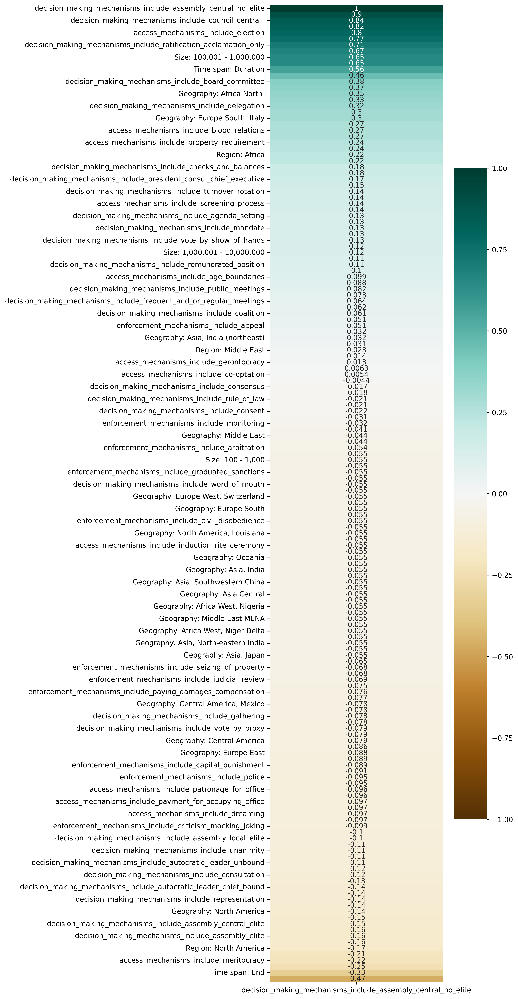

In [70]:
plt.figure(figsize=(10,20))
sns.heatmap(
    central_elite_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'central_no_elite_assemblies_corr.png')
plt.show()

#### Local Assemblies

In [71]:
local_corr = assemblies_corr['decision_making_mechanisms_include_assembly_local']

In [72]:
local_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_local_corr.csv')

In [73]:
local_corr.sort_values(ascending=False)

decision_making_mechanisms_include_assembly_local                                  1.000000
decision_making_mechanisms_include_assembly_local_elite                            0.750085
Geography: Asia, China                                                             0.609121
decision_making_mechanisms_include_assembly_local_no_elite                         0.603222
decision_making_mechanisms_include_alliance                                        0.519443
decision_making_mechanisms_include_kingchief-as-figurehead                         0.517814
Size: 10,000,000+                                                                  0.431549
decision_making_mechanisms_include_autocratic_leader_unbound                       0.420019
decision_making_mechanisms_include_supermajority                                   0.411930
Geography: Europe, North                                                           0.350313
decision_making_mechanisms_include_leader_first_among_equals                    

In [74]:
local_corr.sort_values(ascending=True)

decision_making_mechanisms_include_council_central_                               -0.243012
Region: North America                                                             -0.147038
decision_making_mechanisms_include_board_committee                                -0.129644
Geography: North America                                                          -0.125172
Geography: Europe South, Italy                                                    -0.121451
enforcement_mechanisms_include_jury_judge                                         -0.112722
Geography: Europe West                                                            -0.111979
decision_making_mechanisms_include_autocratic_leader_chief_bound                  -0.110744
Size: 10,001 - 100,000                                                            -0.103700
enforcement_mechanisms_include_self-help                                          -0.100888
enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator 

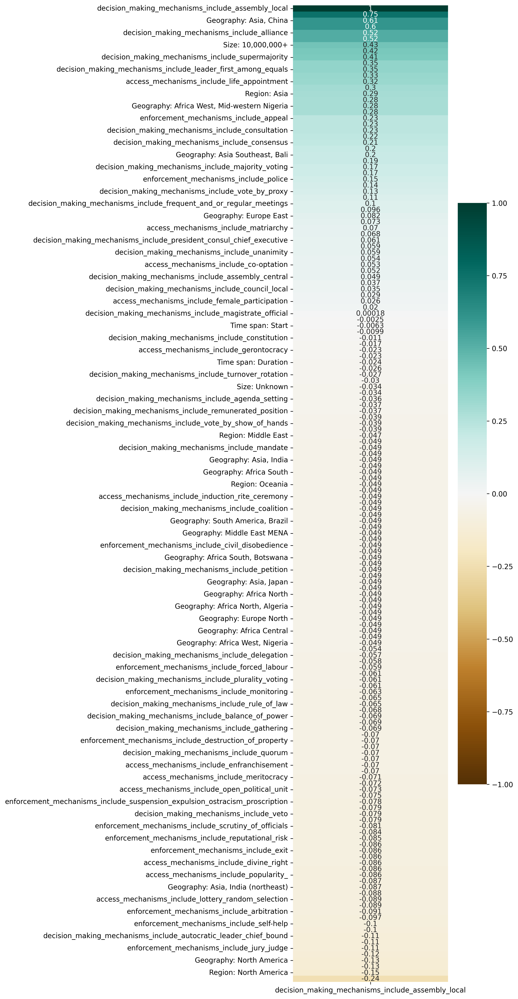

In [75]:
plt.figure(figsize=(10,20))
sns.heatmap(
    local_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'local_assemblies_corr.png')
plt.show()

In [76]:
local_elite_corr = assemblies_corr['decision_making_mechanisms_include_assembly_local_elite']

In [77]:
local_elite_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_local_corr_elite.csv')

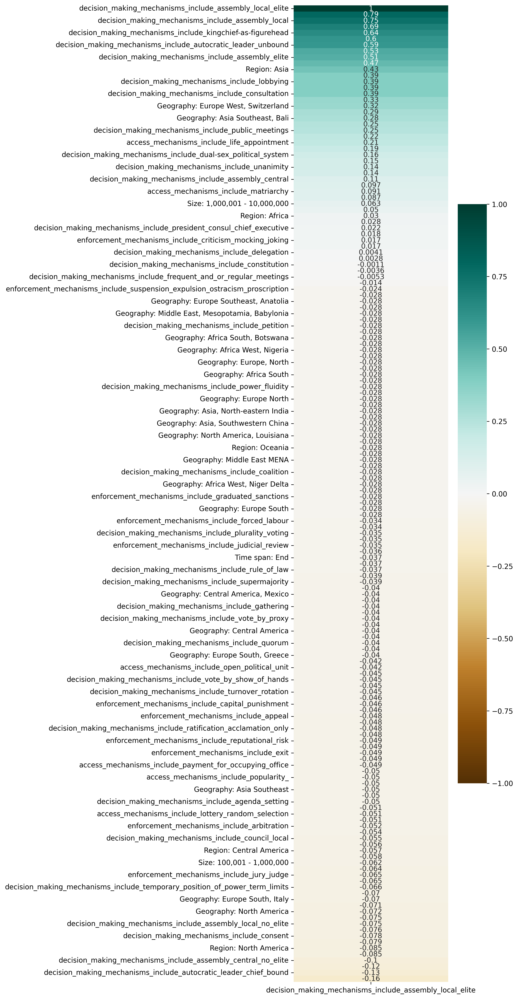

In [78]:
plt.figure(figsize=(10,20))
sns.heatmap(
    local_elite_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'local_elite_assemblies_corr.png')
plt.show()

In [79]:
local_no_elite_corr = assemblies_corr['decision_making_mechanisms_include_assembly_local_no_elite']

In [80]:
local_no_elite_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_local_corr_no_elite.csv')

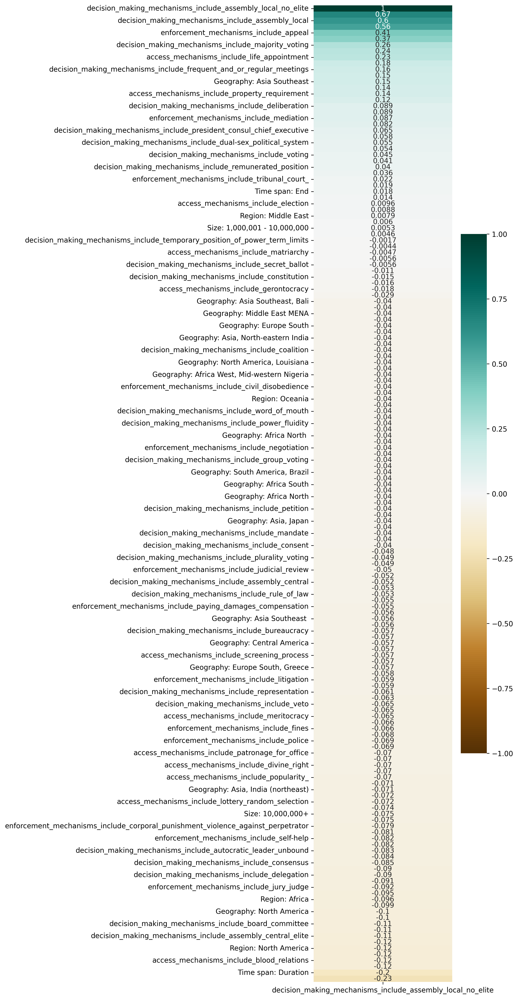

In [82]:
plt.figure(figsize=(10,20))
sns.heatmap(
    local_no_elite_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'local_no_elite_assemblies_corr.png')
plt.show()

#### Elite Assemblies

In [83]:
elite_corr = assemblies_corr['decision_making_mechanisms_include_assembly_elite']

In [84]:
elite_corr.sort_values(ascending=False).to_csv('../csv/v2/assemblies_elite_corr.csv')

In [85]:
elite_corr.sort_values(ascending=False)

decision_making_mechanisms_include_assembly_elite                                  1.000000
decision_making_mechanisms_include_assembly_central_elite                          0.985381
enforcement_mechanisms_include_fines                                               0.698222
Geography: Europe South                                                            0.676233
enforcement_mechanisms_include_seizing_of_property                                 0.643993
decision_making_mechanisms_include_plurality_voting                                0.643993
enforcement_mechanisms_include_judicial_review                                     0.641233
enforcement_mechanisms_include_paying_damages_compensation                         0.631933
enforcement_mechanisms_include_monitoring                                          0.625258
enforcement_mechanisms_include_criticism_mocking_joking                            0.622197
decision_making_mechanisms_include_oath                                         

In [86]:
elite_corr.sort_values(ascending=True)

Size: 10,001 - 100,000                                                            -0.195172
decision_making_mechanisms_include_assembly_central_no_elite                      -0.160383
Time span: Start                                                                  -0.152996
Time span: End                                                                    -0.140952
Region: North America                                                             -0.130904
decision_making_mechanisms_include_assembly_local_no_elite                        -0.116121
decision_making_mechanisms_include_board_committee                                -0.115418
Geography: North America                                                          -0.111437
access_mechanisms_include_matrilineality                                          -0.110503
Geography: Europe South, Italy                                                    -0.108124
Region: Middle East                                                             

In [89]:
plt.figure(figsize=(10,20))
sns.heatmap(
    elite_corr.sort_values(ascending=False).to_frame(),
    annot=True,
    cmap='BrBG',
    vmin=-1,
    vmax=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'elite_assemblies_corr.png')
plt.show()

## Assemblies: Community Analysis 

In [90]:
assemblies_df = gov_df[
    (gov_df['decision_making_mechanisms_include_assembly_central'] == 1) |
    (gov_df['decision_making_mechanisms_include_assembly_local'] == 1) |
    (gov_df['decision_making_mechanisms_include_assembly_elite'] == 1)
]

In [91]:
assemblies_df.to_csv('../csv/v2/assemblies_df.csv')

In [92]:
assemblies_df[assemblies].head()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
1,1,0,1,0,0,0,0
3,1,0,1,0,0,0,0
5,1,1,0,0,0,0,1
6,1,1,0,0,0,0,1
8,1,0,1,0,0,0,0


In [93]:
assemblies_df[assemblies].describe()

,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
count,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000
mean,0.843750,0.281250,0.562500,0.343750,0.125000,0.218750,0.312500
std,0.368902,0.456803,0.504016,0.482559,0.336011,0.420013,0.470929
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [94]:
assemblies_df.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_public_meetings,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_appeal,enforcement_mechanisms_include_tribunal_court_,decision_making_mechanisms_include_kingchief-as-figurehead,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_voting,enforcement_mechanisms_include_mediation,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_checks_and_balances,enforcement_mechanisms_include_judicial_review,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_plurality_voting,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_assembly_central,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_blood_relations,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_autocratic_leader_unbound,access_mechanisms_include_life_appointment,access_mechanisms_include_heredity,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_assembly_elite,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_quorum,access_mechanisms_include_popularity_,decision_making_mechanisms_include_leader_first_among_equals,decision_making_mechanisms_include_balance_of_power,access_mechanisms_include_divine_right,decision_making_mechanisms_include_vote_by_proxy,access_mechanisms_include_co-optation,decision_making_mechanisms_include_constitution,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_chief_bound,enforcement_mechanisms_include_jury_judge,decision_making_mechanisms_include_turnover_rotation,access_mechanisms_include_female_participation,decision_making_mechanisms_include_consultation,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_lobbying,enforcement_mechanisms_include_police,decision_making_mechanisms_include_alliance,access_mechanisms_include_election,enforcement_mechanisms_include_reputational_risk,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_screening_process,access_mechanisms_include_gerontocracy,access_mechanisms_include_payment_for_occupying_office,decision_making_mechanisms_include_board_committee,access_mechanisms_include_property_requirement,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_gathering,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_bureaucracy,access_mechanisms_include_enfranchisement,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_temporary_position_

In [95]:
assemblies_df[assemblies].sum()

decision_making_mechanisms_include_assembly_central             27
decision_making_mechanisms_include_assembly_central_elite        9
decision_making_mechanisms_include_assembly_central_no_elite    18
decision_making_mechanisms_include_assembly_local               11
decision_making_mechanisms_include_assembly_local_elite          4
decision_making_mechanisms_include_assembly_local_no_elite       7
decision_making_mechanisms_include_assembly_elite               10
dtype: int64

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_56373/1544816520.py:3: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


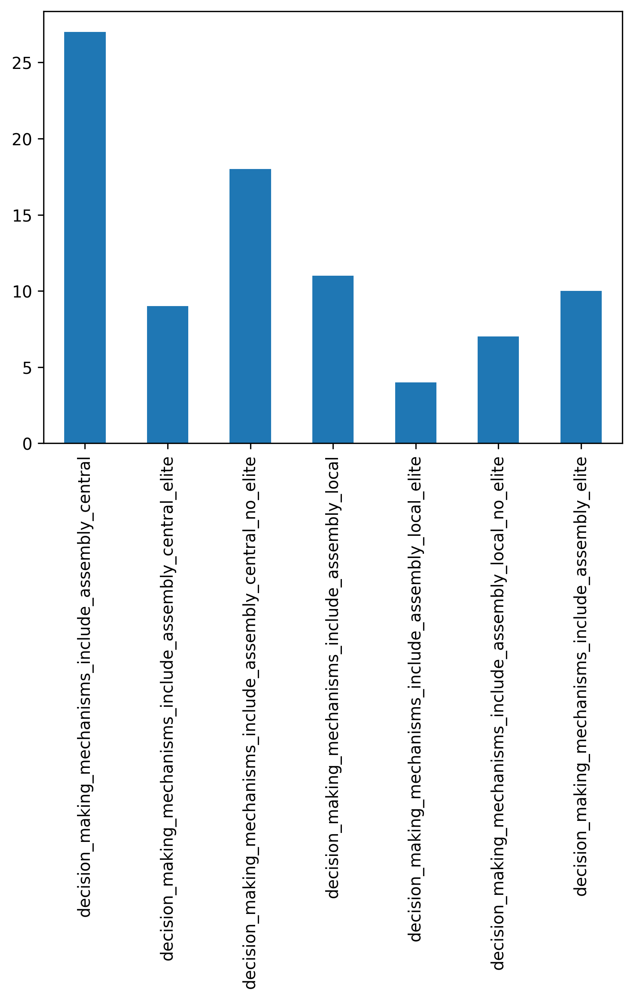

In [96]:
assemblies_df[assemblies].sum().plot(kind='bar')

plt.tight_layout()
plt.savefig(fig_dir + 'assemblies_histogram.png')
plt.show()

In [97]:
# Communities with all three assembly types
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 1)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,China (Spring and Autumn),1,1,0,1,1,0,1
1,Igbo People,1,1,0,1,1,0,1
2,Switzerland,1,1,0,1,1,0,1


In [98]:
# Communities with both central + local 
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 1)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,China (Spring and Autumn),1,1,0,1,1,0,1
1,Dutch Republic,1,0,1,1,0,1,0
2,Iceland,1,0,1,1,0,1,0
3,Igbo People,1,1,0,1,1,0,1
4,Mari,1,0,1,1,0,1,0
5,Switzerland,1,1,0,1,1,0,1


In [99]:
# Communities with central + elite
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 1)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,Assur,1,1,0,0,0,0,1
1,Athens (Classical Period),1,1,0,0,0,0,1
2,China (Spring and Autumn),1,1,0,1,1,0,1
3,England (Anglo Saxon),1,1,0,0,0,0,1
4,Igbo People,1,1,0,1,1,0,1
5,Ijo of the Eastern Niger Delta,1,1,0,0,0,0,1
6,Mongol Nomads,1,1,0,0,0,0,1
7,Samoa,1,1,0,0,0,0,1
8,Switzerland,1,1,0,1,1,0,1


In [100]:
# Communities with central + no elite
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 0)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,Aedui (Celtic Oppida),1,0,1,0,0,0,0
1,Amalfi,1,0,1,0,0,0,0
2,Babylonia,1,0,1,0,0,0,0
3,Carthage,1,0,1,0,0,0,0
4,Communes (Medieval Europe),1,0,1,0,0,0,0
5,Dutch Republic,1,0,1,1,0,1,0
6,Genoa (doge),1,0,1,0,0,0,0
7,Greek democracies,1,0,1,0,0,0,0
8,Greek oligarchies,1,0,1,0,0,0,0
9,Iceland,1,0,1,1,0,1,0


In [101]:
# Communities with local + elite
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 1)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,China (Spring and Autumn),1,1,0,1,1,0,1
1,Igbo People,1,1,0,1,1,0,1
2,Negara Ubud,0,0,0,1,1,0,1
3,Switzerland,1,1,0,1,1,0,1


In [102]:
# Communities with local + no elite
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 0)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,Dutch Republic,1,0,1,1,0,1,0
1,Iceland,1,0,1,1,0,1,0
2,Mari,1,0,1,1,0,1,0
3,Minangkabau,0,0,0,1,0,1,0
4,Nebelivka,0,0,0,1,0,1,0
5,Oaxaca,0,0,0,1,0,1,0
6,Russian Communes,0,0,0,1,0,1,0


In [103]:
# Communities with exclusively central assemblies
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 0) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 0)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,Aedui (Celtic Oppida),1,0,1,0,0,0,0
1,Amalfi,1,0,1,0,0,0,0
2,Babylonia,1,0,1,0,0,0,0
3,Carthage,1,0,1,0,0,0,0
4,Communes (Medieval Europe),1,0,1,0,0,0,0
5,Genoa (doge),1,0,1,0,0,0,0
6,Greek democracies,1,0,1,0,0,0,0
7,Greek oligarchies,1,0,1,0,0,0,0
8,Latium,1,0,1,0,0,0,0
9,Pisa,1,0,1,0,0,0,0


In [104]:
# Communities with exclusively local assemblies
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 0) &
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 1) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 0)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
0,Minangkabau,0,0,0,1,0,1,0
1,Nebelivka,0,0,0,1,0,1,0
2,Oaxaca,0,0,0,1,0,1,0
3,Russian Communes,0,0,0,1,0,1,0


In [105]:
# Communities with exclusively elite assemblies
assemblies_df[
    (assemblies_df['decision_making_mechanisms_include_assembly_central'] == 0) &
    (assemblies_df['decision_making_mechanisms_include_assembly_local'] == 0) &
    (assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 1)
][['Name'] + assemblies].reset_index(drop=True)

,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite


#### Size histogram

In [106]:
assemblies_df[size_cols].sum()

Size: 100 - 1,000                0
Size: 1,001 - 10,000             3
Size: 10,001 - 100,000          15
Size: 100,001 - 1,000,000        4
Size: 1,000,001 - 10,000,000     4
Size: 10,000,000+                2
Size: Unknown                    1
dtype: int64

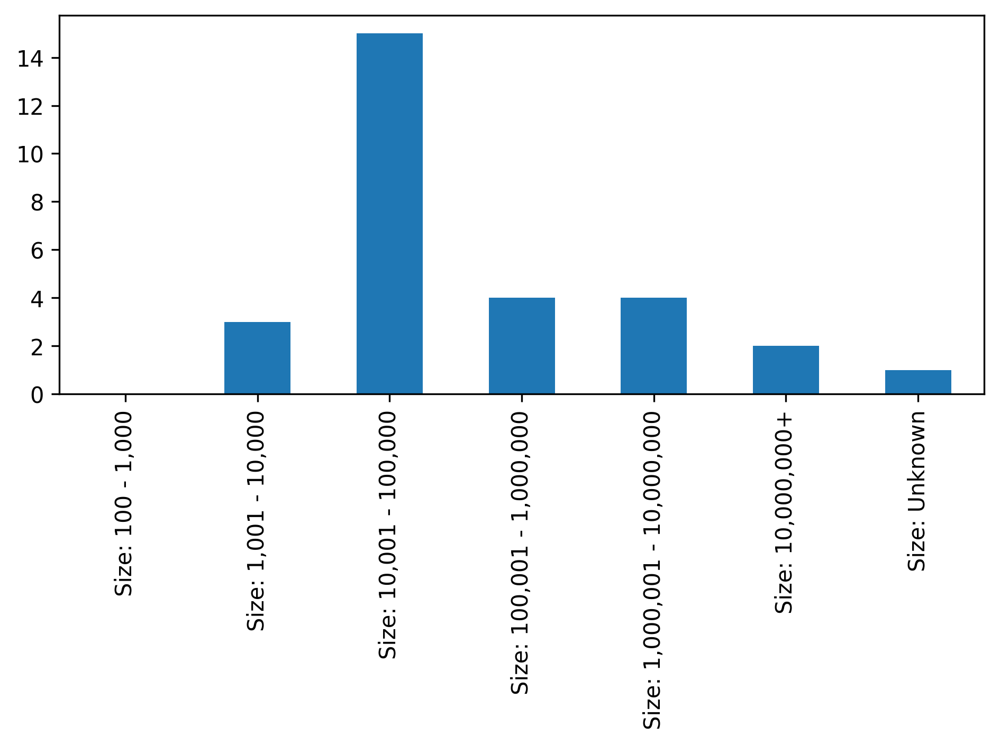

In [107]:
assemblies_df[size_cols].sum().plot(kind='bar')

plt.tight_layout()
plt.savefig(fig_dir + 'assemblies_size_histogram.png')
plt.show()

## Plotting Assembly Timelines 

#### Central Assemblies

In [108]:
central_assemblies_df = assemblies_df[assemblies_df['decision_making_mechanisms_include_assembly_central'] == 1]

In [109]:
central_dates_df = central_assemblies_df[['Time span: Start', 'Time span: Duration', 'Name'] + assemblies]

In [110]:
central_dates_df.head()

,Time span: Start,Time span: Duration,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
1,-200,200,Aedui (Celtic Oppida),1,0,1,0,0,0,0
3,300,900,Amalfi,1,0,1,0,0,0,0
5,-1920,120,Assur,1,1,0,0,0,0,1
6,-508,186,Athens (Classical Period),1,1,0,0,0,0,1
8,-900,300,Babylonia,1,0,1,0,0,0,0


In [111]:
central_dates_tuples = [tuple(x) for x in central_dates_df.to_numpy()]
central_dates_tuples

[(-200, 200, 'Aedui (Celtic Oppida)', 1, 0, 1, 0, 0, 0, 0),
 (300, 900, 'Amalfi', 1, 0, 1, 0, 0, 0, 0),
 (-1920, 120, 'Assur', 1, 1, 0, 0, 0, 0, 1),
 (-508, 186, 'Athens (Classical Period)', 1, 1, 0, 0, 0, 0, 1),
 (-900, 300, 'Babylonia', 1, 0, 1, 0, 0, 0, 0),
 (-400, 300, 'Carthage', 1, 0, 1, 0, 0, 0, 0),
 (-771, 550, 'China (Spring and Autumn)', 1, 1, 0, 1, 1, 0, 1),
 (900, 300, 'Communes (Medieval Europe)', 1, 0, 1, 0, 0, 0, 0),
 (1500, 300, 'Dutch Republic', 1, 0, 1, 1, 0, 1, 0),
 (400, 700, 'England (Anglo Saxon)', 1, 1, 0, 0, 0, 0, 1),
 (1300, 300, 'Genoa (doge)', 1, 0, 1, 0, 0, 0, 0),
 (-480, 453, 'Greek democracies', 1, 0, 1, 0, 0, 0, 0),
 (-480, 453, 'Greek oligarchies', 1, 0, 1, 0, 0, 0, 0),
 (930, 332, 'Iceland ', 1, 0, 1, 1, 0, 1, 0),
 (900, 660, 'Igbo People', 1, 1, 0, 1, 1, 0, 1),
 (1400, 500, 'Ijo of the Eastern Niger Delta', 1, 1, 0, 0, 0, 0, 1),
 (-600, 300, 'Latium', 1, 0, 1, 0, 0, 0, 0),
 (-1800, 40, 'Mari ', 1, 0, 1, 1, 0, 1, 0),
 (900, 400, 'Mongol Nomads', 1, 1, 0

In [112]:
list(central_dates_df.columns.values)

['Time span: Start',
 'Time span: Duration',
 'Name',
 'decision_making_mechanisms_include_assembly_central',
 'decision_making_mechanisms_include_assembly_central_elite',
 'decision_making_mechanisms_include_assembly_central_no_elite',
 'decision_making_mechanisms_include_assembly_local',
 'decision_making_mechanisms_include_assembly_local_elite',
 'decision_making_mechanisms_include_assembly_local_no_elite',
 'decision_making_mechanisms_include_assembly_elite']

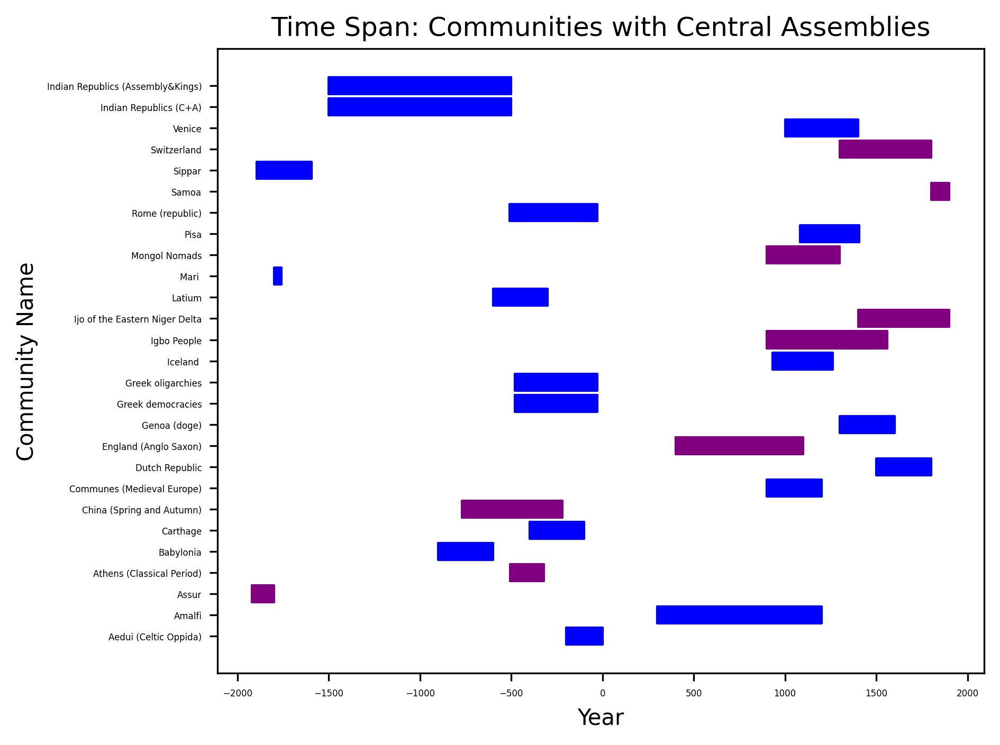

In [113]:
# create figure and plot
fig, ax = plt.subplots()
labels = []
for i, (
    start, 
    duration, 
    label, 
    is_central, 
    is_central_elite, 
    is_central_no_elite, 
    is_local, 
    is_local_elite, 
    is_local_no_elite, 
    is_elite
) in enumerate(central_dates_tuples):
    if is_elite:
        bar_color = 'purple'
    else:
        bar_color = 'blue'
    
    labels.append(label)
    ax.broken_barh(
        [(start, duration)], 
        (i-0.4,0.8),
        color=bar_color
    )
    
# set yticks at the middle of the bars
ax.set_yticks(range(len(central_dates_tuples)))
ax.set_yticklabels(labels)
ax.tick_params(axis='both', which='major', labelsize=4)

ax.set_xlabel('Year')
ax.set_ylabel('Community Name')

plt.title('Time Span: Communities with Central Assemblies')
# plt.figure(figsize=(80, 80))

plt.tight_layout()
plt.savefig(fig_dir + 'timeline_central_assemblies.png')
plt.show()

#### Local Assemblies

In [114]:
local_assemblies_df = assemblies_df[assemblies_df['decision_making_mechanisms_include_assembly_local'] == 1]

In [115]:
local_dates_df = local_assemblies_df[['Time span: Start', 'Time span: Duration', 'Name'] + assemblies]

In [116]:
local_dates_df.head()

,Time span: Start,Time span: Duration,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
11,-771,550,China (Spring and Autumn),1,1,0,1,1,0,1
15,1500,300,Dutch Republic,1,0,1,1,0,1,0
28,930,332,Iceland,1,0,1,1,0,1,0
29,900,660,Igbo People,1,1,0,1,1,0,1
39,-1800,40,Mari,1,0,1,1,0,1,0


In [117]:
local_dates_tuples = [tuple(x) for x in local_dates_df.to_numpy()]
local_dates_tuples

[(-771, 550, 'China (Spring and Autumn)', 1, 1, 0, 1, 1, 0, 1),
 (1500, 300, 'Dutch Republic', 1, 0, 1, 1, 0, 1, 0),
 (930, 332, 'Iceland ', 1, 0, 1, 1, 0, 1, 0),
 (900, 660, 'Igbo People', 1, 1, 0, 1, 1, 0, 1),
 (-1800, 40, 'Mari ', 1, 0, 1, 1, 0, 1, 0),
 (1800, 100, 'Minangkabau', 0, 0, 0, 1, 0, 1, 0),
 (-4100, 800, 'Nebelivka', 0, 0, 0, 1, 0, 1, 0),
 (1800, 100, 'Negara Ubud', 0, 0, 0, 1, 1, 0, 1),
 (1900, 100, 'Oaxaca', 0, 0, 0, 1, 0, 1, 0),
 (1500, 400, 'Russian Communes', 0, 0, 0, 1, 0, 1, 0),
 (1300, 500, 'Switzerland', 1, 1, 0, 1, 1, 0, 1)]

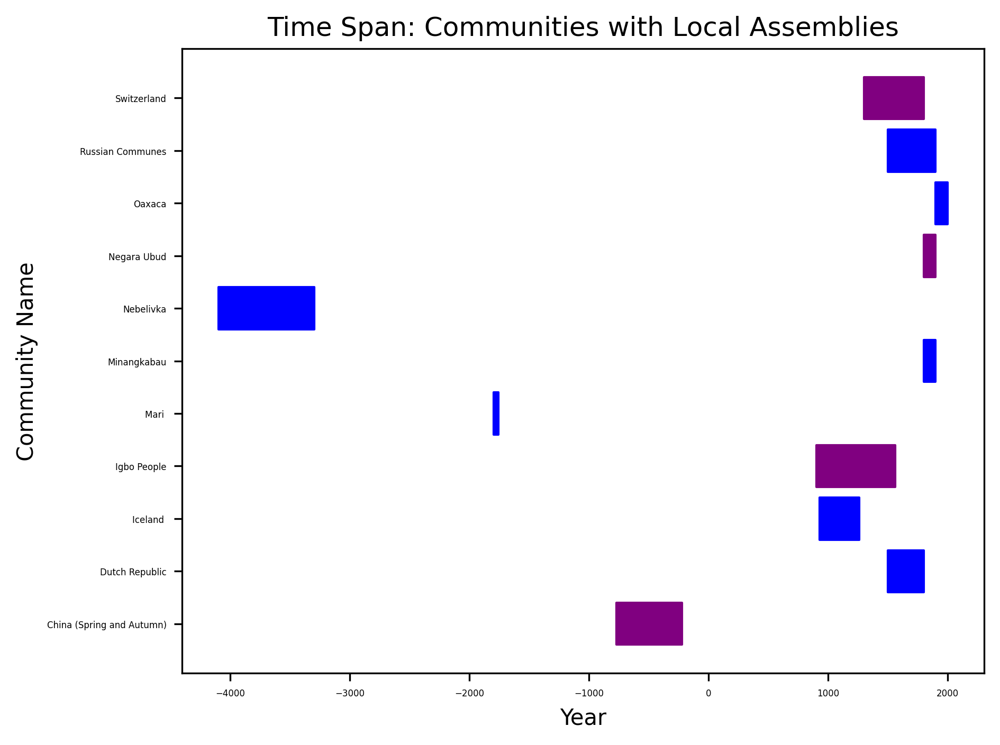

In [118]:
# create figure and plot
fig, ax = plt.subplots()
labels = []
for i, (
    start, 
    duration, 
    label, 
    is_central, 
    is_central_elite, 
    is_central_no_elite, 
    is_local, 
    is_local_elite, 
    is_local_no_elite, 
    is_elite
) in enumerate(local_dates_tuples):
    if is_elite:
        bar_color = 'purple'
    else:
        bar_color = 'blue'
    
    labels.append(label)
    ax.broken_barh(
        [(start, duration)], 
        (i-0.4,0.8),
        color=bar_color
)

# set yticks at the middle of the bars
ax.set_yticks(range(len(local_dates_tuples)))
ax.set_yticklabels(labels)
ax.tick_params(axis='both', which='major', labelsize=4)

ax.set_xlabel('Year')
ax.set_ylabel('Community Name')

plt.title('Time Span: Communities with Local Assemblies')
# plt.figure(figsize=(80, 80))

plt.tight_layout()
plt.savefig(fig_dir + 'timeline_local_assemblies.png')
plt.show()

#### Elite Assemblies

In [119]:
elite_assemblies_df = assemblies_df[assemblies_df['decision_making_mechanisms_include_assembly_elite'] == 1]

In [120]:
elite_dates_df = elite_assemblies_df[['Time span: Start', 'Time span: Duration', 'Name'] + assemblies]

In [139]:
elite_dates_df.head()

,Time span: Start,Time span: Duration,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
5,-1920,120,Assur,1,1,0,0,0,0,1
6,-508,186,Athens (Classical Period),1,1,0,0,0,0,1
11,-771,550,China (Spring and Autumn),1,1,0,1,1,0,1
18,400,700,England (Anglo Saxon),1,1,0,0,0,0,1
29,900,660,Igbo People,1,1,0,1,1,0,1


In [140]:
elite_dates_tuples = [tuple(x) for x in elite_dates_df.to_numpy()]
elite_dates_tuples

[(-1920, 120, 'Assur', 1, 1, 0, 0, 0, 0, 1),
 (-508, 186, 'Athens (Classical Period)', 1, 1, 0, 0, 0, 0, 1),
 (-771, 550, 'China (Spring and Autumn)', 1, 1, 0, 1, 1, 0, 1),
 (400, 700, 'England (Anglo Saxon)', 1, 1, 0, 0, 0, 0, 1),
 (900, 660, 'Igbo People', 1, 1, 0, 1, 1, 0, 1),
 (1400, 500, 'Ijo of the Eastern Niger Delta', 1, 1, 0, 0, 0, 0, 1),
 (900, 400, 'Mongol Nomads', 1, 1, 0, 0, 0, 0, 1),
 (1800, 100, 'Negara Ubud', 0, 0, 0, 1, 1, 0, 1),
 (1800, 100, 'Samoa', 1, 1, 0, 0, 0, 0, 1),
 (1300, 500, 'Switzerland', 1, 1, 0, 1, 1, 0, 1)]

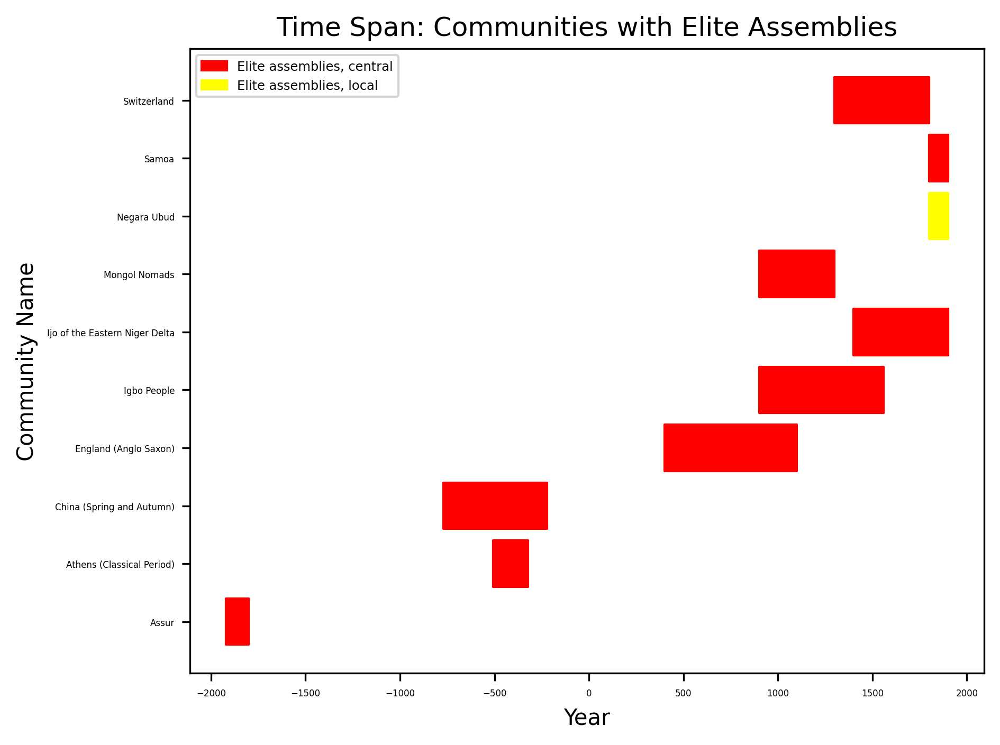

In [141]:
# create figure and plot
fig, ax = plt.subplots()
labels = []
for i, (
    start, 
    duration, 
    label, 
    is_central, 
    is_central_elite, 
    is_central_no_elite, 
    is_local, 
    is_local_elite, 
    is_local_no_elite, 
    is_elite
) in enumerate(elite_dates_tuples):
    if is_central:
        bar_color = 'red'
    else:
        bar_color = 'yellow'
    
    labels.append(label)
    ax.broken_barh(
        [(start, duration)], 
        (i-0.4,0.8),
        color=bar_color
)

# set yticks at the middle of the bars
ax.set_yticks(range(len(elite_dates_tuples)))
ax.set_yticklabels(labels)
ax.tick_params(axis='both', which='major', labelsize=4)

ax.set_xlabel('Year')
ax.set_ylabel('Community Name')

plt.title('Time Span: Communities with Elite Assemblies')
# plt.figure(figsize=(80, 80))

# Create legend
red_patch = mpatches.Patch(color='red', label='Elite assemblies, central')
yellow_patch = mpatches.Patch(color='yellow', label='Elite assemblies, local')

ax.legend(
    handles=[
        red_patch,
        yellow_patch,
    ],
    loc='upper left',
    fontsize='xx-small'
)

plt.tight_layout()
plt.savefig(fig_dir + 'timeline_elite_assemblies.png')
plt.show()

#### All Assembly Types

In [142]:
all_dates_df = assemblies_df[['Time span: Start', 'Time span: Duration', 'Name'] + assemblies]

In [143]:
all_dates_df.head()

,Time span: Start,Time span: Duration,Name,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_assembly_central_elite,decision_making_mechanisms_include_assembly_central_no_elite,decision_making_mechanisms_include_assembly_local,decision_making_mechanisms_include_assembly_local_elite,decision_making_mechanisms_include_assembly_local_no_elite,decision_making_mechanisms_include_assembly_elite
1,-200,200,Aedui (Celtic Oppida),1,0,1,0,0,0,0
3,300,900,Amalfi,1,0,1,0,0,0,0
5,-1920,120,Assur,1,1,0,0,0,0,1
6,-508,186,Athens (Classical Period),1,1,0,0,0,0,1
8,-900,300,Babylonia,1,0,1,0,0,0,0


In [144]:
all_dates_tuples = [tuple(x) for x in all_dates_df.to_numpy()]
all_dates_tuples

[(-200, 200, 'Aedui (Celtic Oppida)', 1, 0, 1, 0, 0, 0, 0),
 (300, 900, 'Amalfi', 1, 0, 1, 0, 0, 0, 0),
 (-1920, 120, 'Assur', 1, 1, 0, 0, 0, 0, 1),
 (-508, 186, 'Athens (Classical Period)', 1, 1, 0, 0, 0, 0, 1),
 (-900, 300, 'Babylonia', 1, 0, 1, 0, 0, 0, 0),
 (-400, 300, 'Carthage', 1, 0, 1, 0, 0, 0, 0),
 (-771, 550, 'China (Spring and Autumn)', 1, 1, 0, 1, 1, 0, 1),
 (900, 300, 'Communes (Medieval Europe)', 1, 0, 1, 0, 0, 0, 0),
 (1500, 300, 'Dutch Republic', 1, 0, 1, 1, 0, 1, 0),
 (400, 700, 'England (Anglo Saxon)', 1, 1, 0, 0, 0, 0, 1),
 (1300, 300, 'Genoa (doge)', 1, 0, 1, 0, 0, 0, 0),
 (-480, 453, 'Greek democracies', 1, 0, 1, 0, 0, 0, 0),
 (-480, 453, 'Greek oligarchies', 1, 0, 1, 0, 0, 0, 0),
 (930, 332, 'Iceland ', 1, 0, 1, 1, 0, 1, 0),
 (900, 660, 'Igbo People', 1, 1, 0, 1, 1, 0, 1),
 (1400, 500, 'Ijo of the Eastern Niger Delta', 1, 1, 0, 0, 0, 0, 1),
 (-600, 300, 'Latium', 1, 0, 1, 0, 0, 0, 0),
 (-1800, 40, 'Mari ', 1, 0, 1, 1, 0, 1, 0),
 (1800, 100, 'Minangkabau', 0, 0, 0,

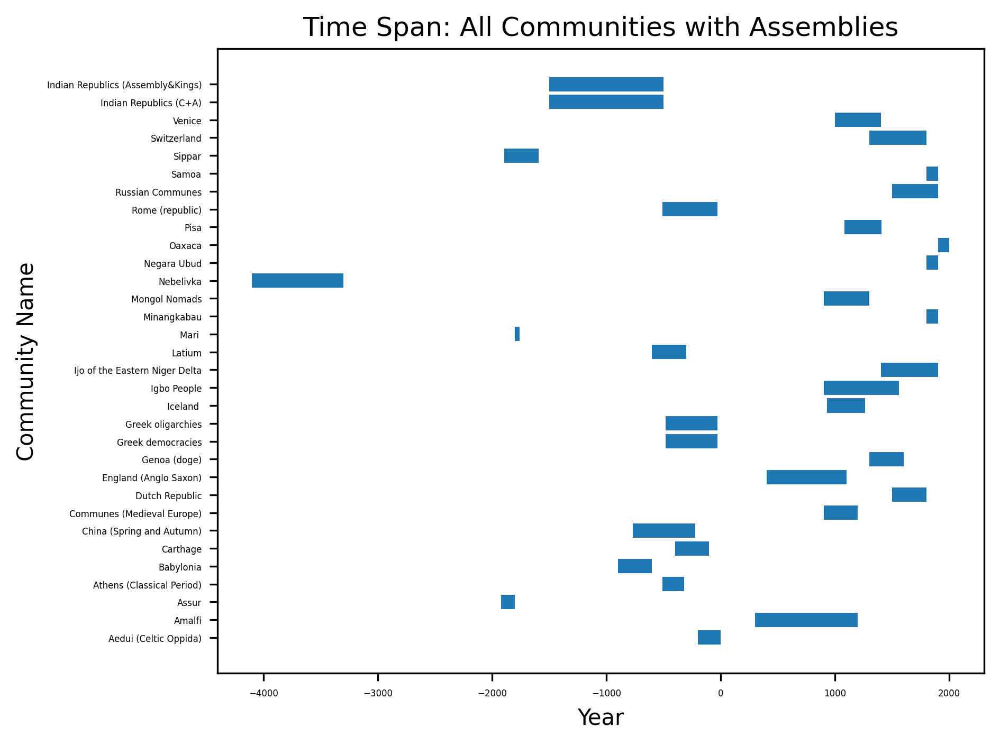

In [145]:
# Create figure and plot
fig, ax = plt.subplots()
labels = []

for i, (
    start, 
    duration, 
    label, 
    is_central, 
    is_central_elite, 
    is_central_no_elite, 
    is_local, 
    is_local_elite, 
    is_local_no_elite, 
    is_elite
) in enumerate(all_dates_tuples):
    labels.append(label)
    ax.broken_barh(
        [(start, duration)], 
        (i-0.4,0.8)
    )

# Set yticks at the middle of the bars
ax.set_yticks(range(len(all_dates_tuples)))
ax.set_yticklabels(labels)
ax.tick_params(axis='both', which='major', labelsize=4)

ax.set_xlabel('Year')
ax.set_ylabel('Community Name')

plt.title('Time Span: All Communities with Assemblies')
# plt.figure(figsize=(80, 80))

plt.tight_layout()
plt.savefig(fig_dir + 'timeline_assemblies_basic.png')
plt.show()

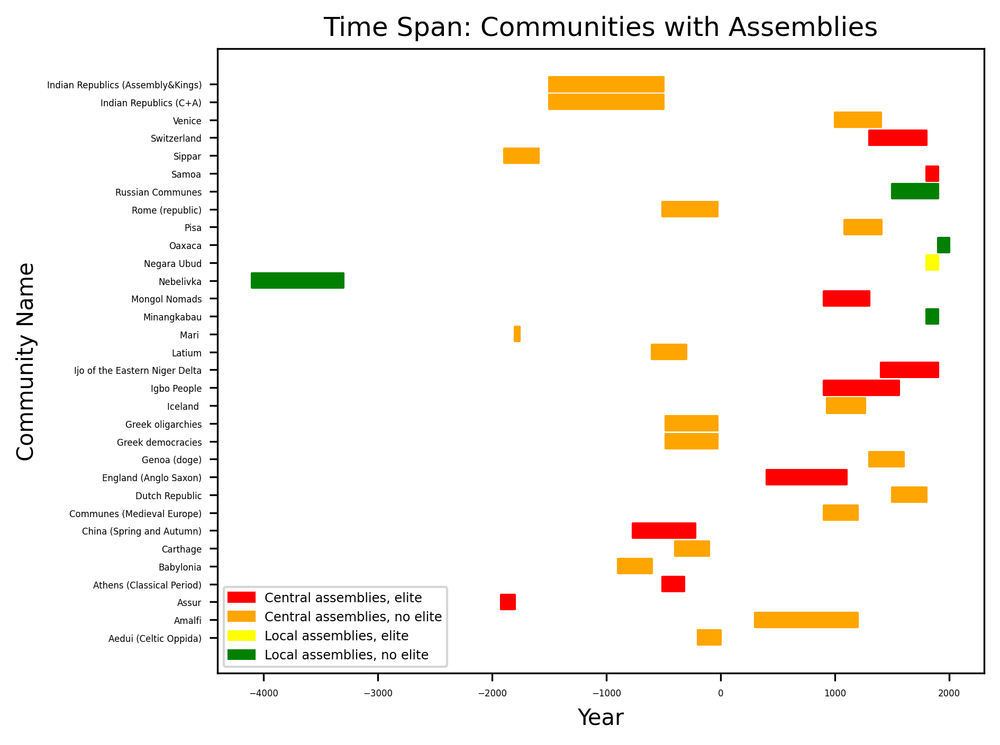

In [146]:
# Create figure and plot
fig, ax = plt.subplots()
labels = []

for i, (
    start, 
    duration, 
    label, 
    is_central, 
    is_central_elite, 
    is_central_no_elite, 
    is_local, 
    is_local_elite, 
    is_local_no_elite, 
    is_elite
) in enumerate(all_dates_tuples):
    
    # Set color based on assembly type
    if is_central_elite:
        bar_color = 'red'
    elif is_central_no_elite:
        bar_color = 'orange'
    
    elif is_local_elite:
        bar_color = 'yellow'
    elif is_local_no_elite:
        bar_color = 'green'
        
    else:
        bar_color = 'grey'
    
    labels.append(label)
    ax.broken_barh(
        [(start, duration)], 
        (i-0.4,0.8),
        color=bar_color
    )

# Set yticks at the middle of the bars
ax.set_yticks(range(len(all_dates_tuples)))
ax.set_yticklabels(labels)
ax.tick_params(axis='both', which='major', labelsize=4)

ax.set_xlabel('Year')
ax.set_ylabel('Community Name')

# Create legend
red_patch = mpatches.Patch(color='red', label='Central assemblies, elite')
orange_patch = mpatches.Patch(color='orange', label='Central assemblies, no elite')
yellow_patch = mpatches.Patch(color='yellow', label='Local assemblies, elite')
green_patch = mpatches.Patch(color='green', label='Local assemblies, no elite')

ax.legend(
    handles=[
        red_patch,
        orange_patch,
        yellow_patch,
        green_patch,
    ],
    loc='lower left',
    fontsize='xx-small'
)

plt.title('Time Span: Communities with Assemblies')
# plt.figure(figsize=(80, 80))

plt.tight_layout()
plt.savefig(fig_dir + 'timeline_assemblies.png')
plt.show()

## Mapping Assembly Regions

#### Prep map data

In [147]:
worldmap = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_56373/3744710904.py:1: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  worldmap = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))


In [148]:
worldmap.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [149]:
central_america_countries = [
    'Belize',
    'Costa Rica',
    'El Salvador',
    'Guatemala',
    'Honduras',
    'Nicaragua',
    'Panama'
]

In [150]:
middle_east_countries = [
    'Cyprus',
    'Egypt',
    'Iran',
    'Iraq',
    'Israel',
    'Jordan',
    'Kuwait',
    'Lebanon',
    'Oman',
    'Palestine',
    'Qatar',
    'Saudi Arabia',
    'Syria',
    'Turkey',
    'United Arab Emirates',
    'Yemen'
]

In [151]:
# Add region for Central America
worldmap.loc[(worldmap['name'].isin(central_america_countries)), 'continent'] = 'Central America'

In [152]:
# Add region for Middle East
worldmap.loc[(worldmap['name'].isin(middle_east_countries)), 'continent'] = 'Middle East'

In [153]:
worldmap['continent'].value_counts()

continent
Africa                     50
Europe                     39
Asia                       32
Middle East                16
South America              13
North America              11
Oceania                     7
Central America             7
Seven seas (open ocean)     1
Antarctica                  1
Name: count, dtype: int64

##### Merge regions on world map

In [154]:
region_map = gpd.GeoDataFrame(columns=['Region', 'geometry'])

In [155]:
regions_list = list(gov_df['Region'].unique())

In [156]:
region_map['Region'] = regions_list

In [157]:
region_map['geometry'].loc[region_map['Region'] == 'Africa'] = worldmap.loc[(worldmap['continent'] == 'Africa')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'Europe'] = worldmap.loc[(worldmap['continent'] == 'Europe')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'Asia'] = worldmap.loc[(worldmap['continent'] == 'Asia')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'Middle East'] = worldmap.loc[(worldmap['continent'] == 'Middle East')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'North America'] = worldmap.loc[(worldmap['continent'] == 'North America')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'Central America'] = worldmap.loc[(worldmap['continent'] == 'Central America')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'South America'] = worldmap.loc[(worldmap['continent'] == 'South America')].unary_union
region_map['geometry'].loc[region_map['Region'] == 'Oceania'] = worldmap.loc[(worldmap['continent'] == 'Oceania')].unary_union

In [200]:
region_map

,Region,geometry
0,Africa,"MULTIPOLYGON (((-11.439 6.786, -11.708 6.860, ..."
1,Europe,"MULTIPOLYGON (((-53.555 2.335, -53.779 2.377, ..."
2,Asia,"MULTIPOLYGON (((105.857 -4.306, 105.818 -5.852..."
3,Middle East,"MULTIPOLYGON (((25.000 25.682, 25.000 29.239, ..."
4,Central America,"POLYGON ((-77.243 7.935, -77.431 7.638, -77.75..."
5,North America,"MULTIPOLYGON (((-155.222 19.240, -155.542 19.0..."
6,South America,"MULTIPOLYGON (((-68.640 -55.580, -69.232 -55.4..."
7,Oceania,"MULTIPOLYGON (((147.914 -43.212, 147.565 -42.9..."


In [214]:
assemblies_region_map = region_map

In [232]:
all_regions_df = pd.DataFrame(
    [
        ['North America',0],
        ['South America', 0],
        ['Europe',0],
        ['Asia',0],
        ['Middle East',0],
        ['Africa',0],
        ['Central America',0],
        ['Oceania',0]
    ], 
    columns=['Region', 'Count']
)

all_regions_df

,Region,Count
0,North America,0
1,South America,0
2,Europe,0
3,Asia,0
4,Middle East,0
5,Africa,0
6,Central America,0
7,Oceania,0


In [231]:
assemblies_region_counts = assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')
assemblies_region_counts

,Region,Count
0,Europe,18
1,Asia,6
2,Middle East,3
3,Africa,3
4,Central America,1
5,Oceania,1


Note: Missing regions include North America, South America

In [248]:
all_assemblies_regions = pd.merge(assemblies_region_counts, all_regions_df, how='outer')
all_assemblies_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
all_assemblies_regions

,Region,Count
0,Europe,18
1,Asia,6
2,Middle East,3
3,Africa,3
4,Central America,1
5,Oceania,1
6,North America,0
7,South America,0


In [249]:
merged_regions = pd.merge(assemblies_region_map, all_assemblies_regions, on='Region')
merged_regions

,Region,geometry,Count
0,Africa,"MULTIPOLYGON (((-11.439 6.786, -11.708 6.860, ...",3
1,Europe,"MULTIPOLYGON (((-53.555 2.335, -53.779 2.377, ...",18
2,Asia,"MULTIPOLYGON (((105.857 -4.306, 105.818 -5.852...",6
3,Middle East,"MULTIPOLYGON (((25.000 25.682, 25.000 29.239, ...",3
4,Central America,"POLYGON ((-77.243 7.935, -77.431 7.638, -77.75...",1
5,North America,"MULTIPOLYGON (((-155.222 19.240, -155.542 19.0...",0
6,South America,"MULTIPOLYGON (((-68.640 -55.580, -69.232 -55.4...",0
7,Oceania,"MULTIPOLYGON (((147.914 -43.212, 147.565 -42.9...",1


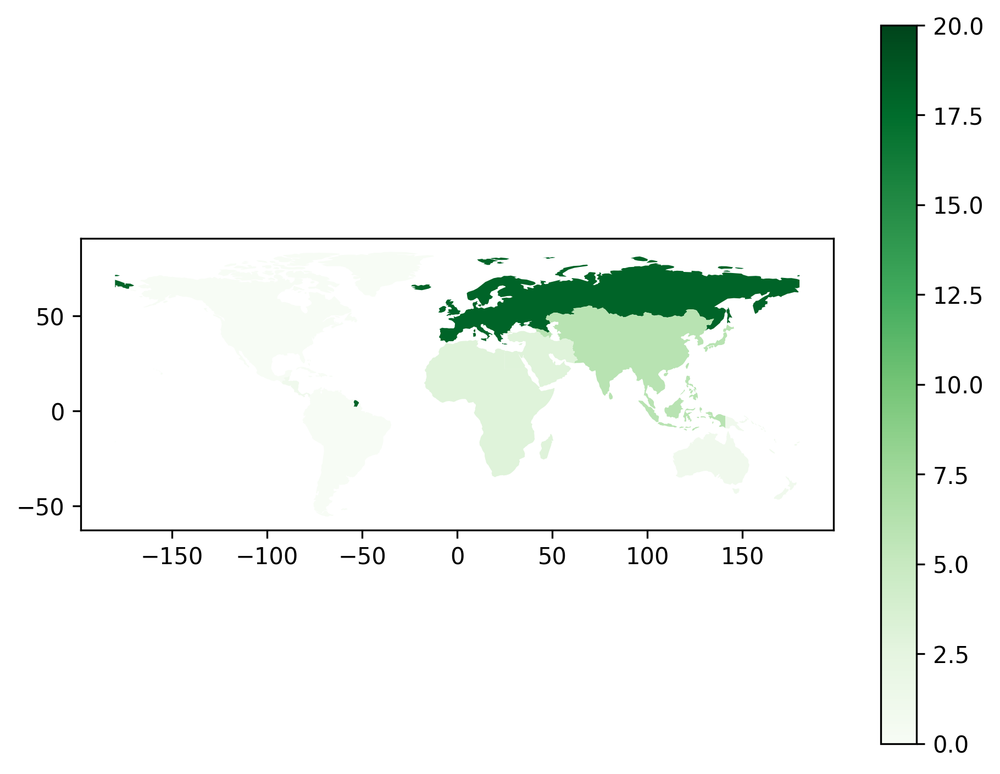

In [246]:
merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_all_assemblies.png')
plt.show()

### Central, all

In [260]:
central_assemblies_region_counts = central_assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')
central_assemblies_region_counts

,Region,Count
0,Europe,16
1,Asia,4
2,Middle East,3
3,Africa,3
4,Oceania,1


In [261]:
all_central_regions = pd.merge(central_assemblies_region_counts, all_regions_df, how='outer')
all_central_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
all_central_regions

,Region,Count
0,Europe,16
1,Asia,4
2,Middle East,3
3,Africa,3
4,Oceania,1
5,North America,0
6,South America,0
7,Central America,0


In [262]:
central_merged_regions = pd.merge(region_map, all_central_regions, on='Region')

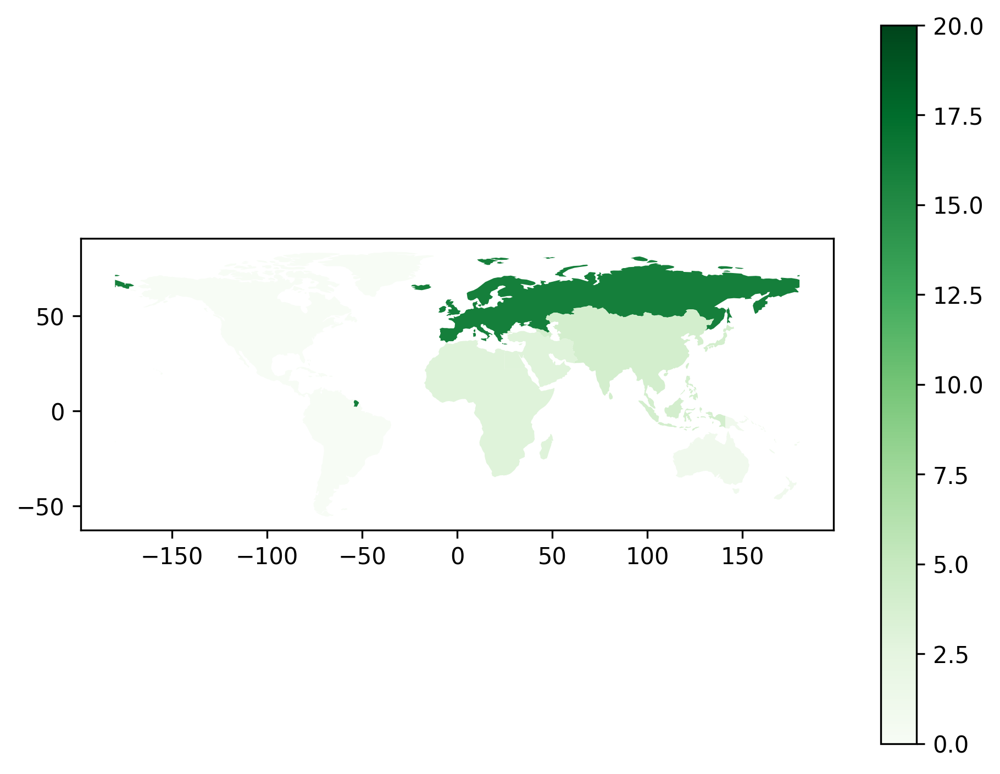

In [263]:
central_merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_central_assemblies.png')
plt.show()

### Central, elite

In [264]:
central_elite_assemblies_df = central_assemblies_df.loc[central_assemblies_df['decision_making_mechanisms_include_assembly_central_elite'] == 1]

In [265]:
central_elite_assemblies_region_counts = central_elite_assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')

In [267]:
all_central_elite_regions = pd.merge(central_elite_assemblies_region_counts, all_regions_df, how='outer')
all_central_elite_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
all_central_elite_regions

,Region,Count
0,Europe,4
1,Asia,2
2,Africa,2
3,Oceania,1
4,North America,0
5,South America,0
6,Middle East,0
7,Central America,0


In [268]:
central_elite_merged_regions = pd.merge(region_map, all_central_elite_regions, on='Region')

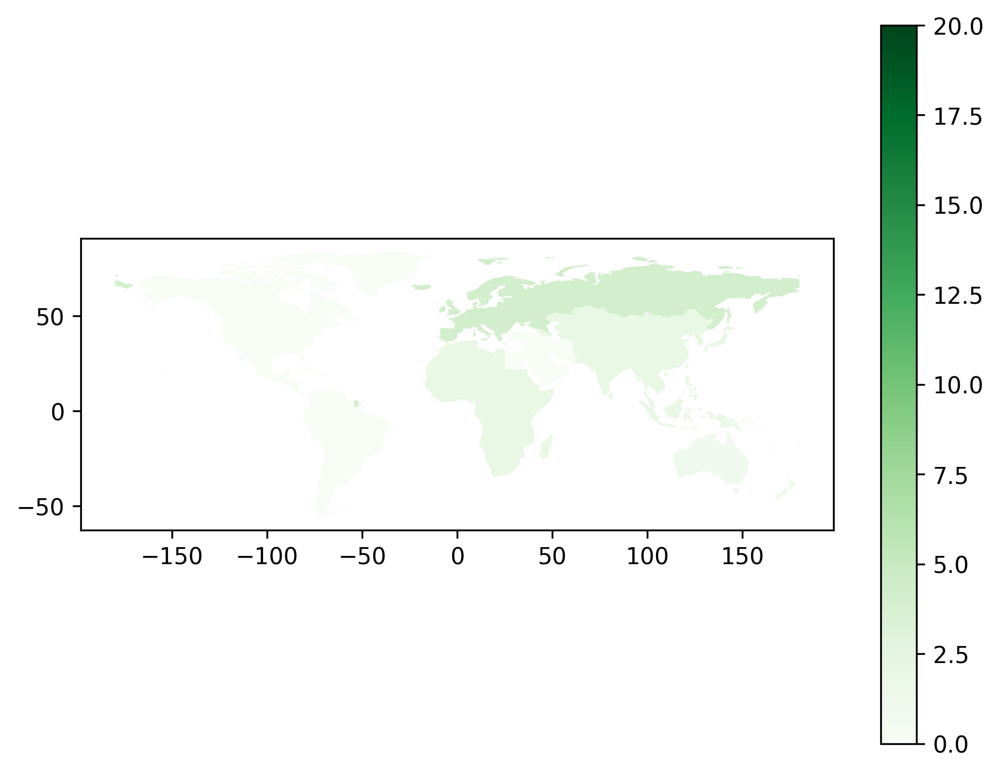

In [269]:
central_elite_merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_central_elite_assemblies.png')
plt.show()

### Central, no elite

In [171]:
central_no_elite_assemblies_df = central_assemblies_df.loc[central_assemblies_df['decision_making_mechanisms_include_assembly_central_no_elite'] == 1]

In [271]:
central_no_elite_assemblies_region_counts = central_no_elite_assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')

all_central_no_elite_regions = pd.merge(central_no_elite_assemblies_region_counts, all_regions_df, how='outer')
all_central_no_elite_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
all_central_no_elite_regions

central_no_elite_merged_regions = pd.merge(region_map, all_central_no_elite_regions, on='Region')

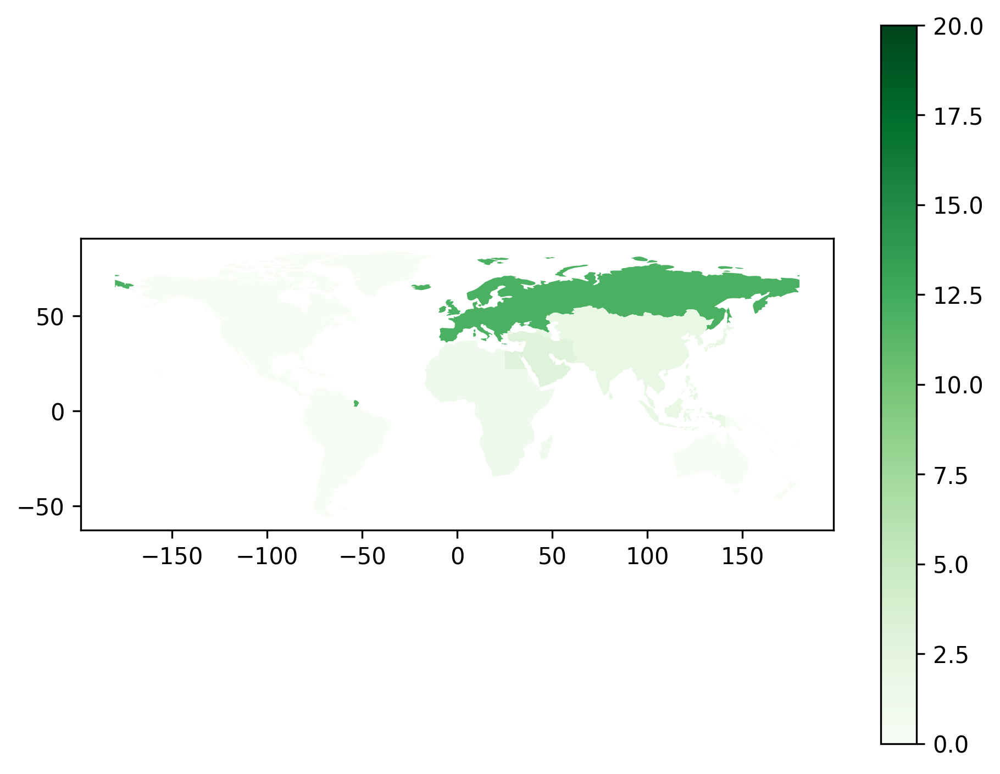

In [272]:
central_no_elite_merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_central_no_elite_assemblies.png')
plt.show()

### Local, all

In [273]:
local_assemblies_region_counts = local_assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')
local_assemblies_region_counts

,Region,Count
0,Europe,5
1,Asia,3
2,Africa,1
3,Middle East,1
4,Central America,1


In [274]:
local_merged_regions = pd.merge(region_map, local_assemblies_region_counts, on='Region')

In [275]:
all_local_regions = pd.merge(local_assemblies_region_counts, all_regions_df, how='outer')
all_local_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
all_local_regions

local_merged_regions = pd.merge(region_map, all_local_regions, on='Region')

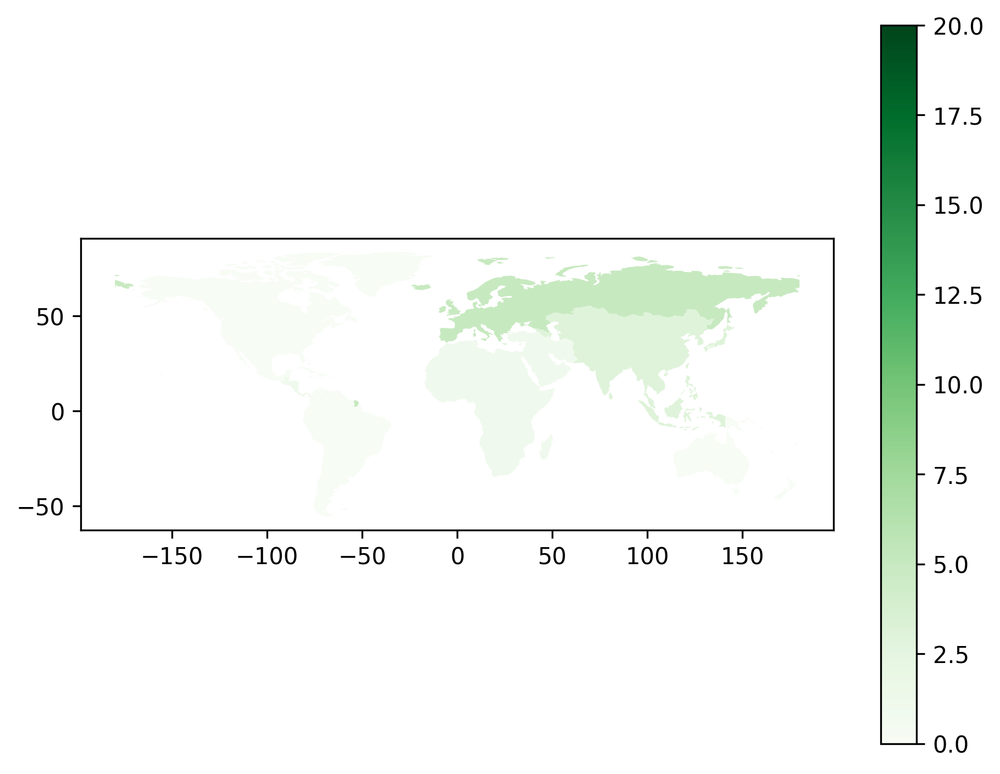

In [276]:
local_merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_local_assemblies.png')
plt.show()

### Local, elite

In [181]:
local_elite_assemblies_df = local_assemblies_df.loc[local_assemblies_df['decision_making_mechanisms_include_assembly_local_elite'] == 1]

In [277]:
local_elite_assemblies_region_counts = local_elite_assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')

local_elite_regions = pd.merge(local_elite_assemblies_region_counts, all_regions_df, how='outer')
local_elite_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
local_elite_regions

local_elite_merged_regions = pd.merge(region_map, local_elite_regions, on='Region')

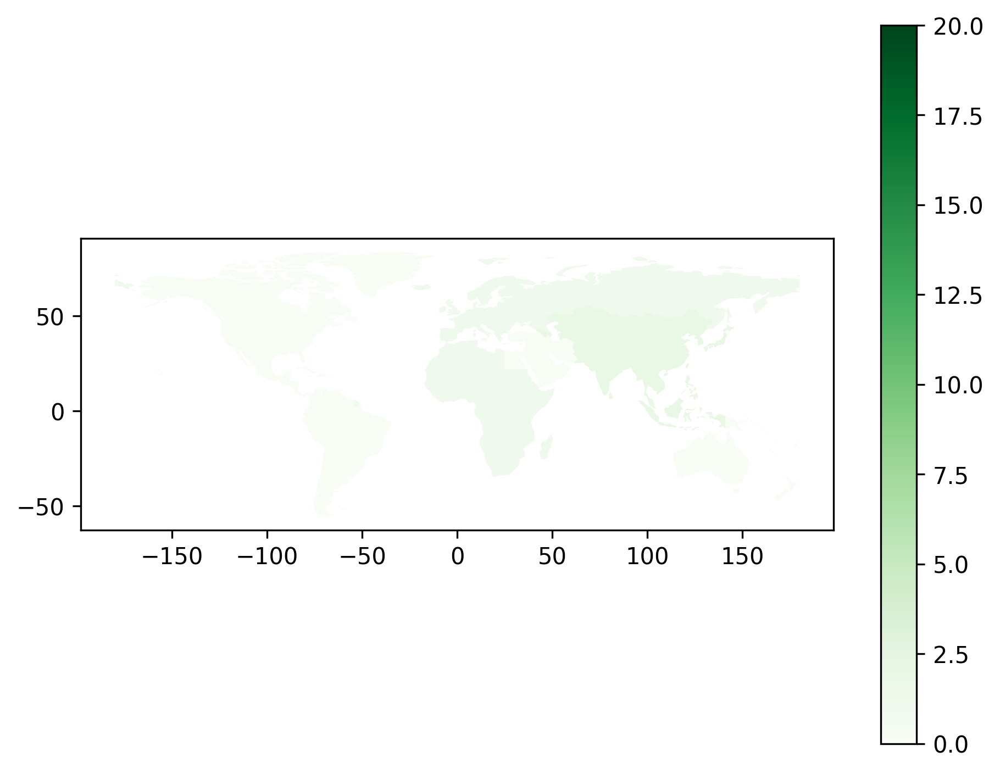

In [278]:
local_elite_merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_local_elite_assemblies.png')
plt.show()

### Local, no elite

In [279]:
local_no_elite_assemblies_df = local_assemblies_df.loc[local_assemblies_df['decision_making_mechanisms_include_assembly_local_no_elite'] == 1]

In [280]:
local_no_elite_assemblies_region_counts = local_no_elite_assemblies_df['Region'].value_counts().rename_axis('Region').reset_index(name='Count')

local_no_elite_regions = pd.merge(local_no_elite_assemblies_region_counts, all_regions_df, how='outer')
local_no_elite_regions.drop_duplicates(subset=['Region'], keep='first', inplace=True, ignore_index=True)
local_no_elite_regions

local_no_elite_merged_regions = pd.merge(region_map, local_no_elite_regions, on='Region')

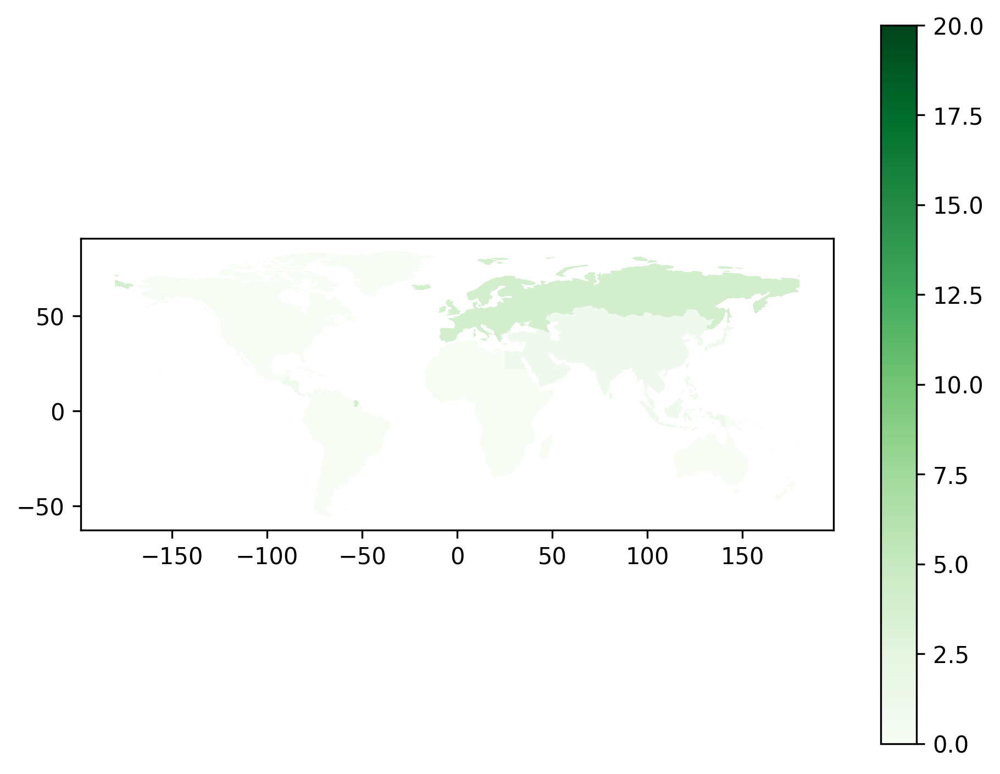

In [281]:
local_no_elite_merged_regions.plot(
    column='Count', 
    legend=True,
    cmap='Greens',
    vmin=0,
    vmax=20
)

plt.tight_layout()
plt.savefig(fig_dir + 'map_local_no_elite_assemblies.png')
plt.show()